<a href="https://colab.research.google.com/github/LeoTU911/SCC413/blob/main/convAE_epoch100.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!git clone https://github.com/LeoTU911/SCC413

Cloning into 'SCC413'...
remote: Enumerating objects: 796, done.
remote: Counting objects: 100% (64/64), done.
remote: Compressing objects: 100% (61/61), done.
remote: Total 796 (delta 23), reused 11 (delta 3), pack-reused 732
Receiving objects: 100% (796/796), 170.67 MiB | 15.00 MiB/s, done.
Resolving deltas: 100% (125/125), done.


In [2]:
import os
import tensorflow as tf
import pathlib
import numpy as np
import matplotlib.pyplot as plt
import keras
import cv2
from keras import backend as K
from keras import losses
from keras.layers import Input, Dense, Lambda, Flatten, Reshape
from keras.layers import Conv2D, Conv2DTranspose, Cropping2D, Dropout
from keras.models import Model
from tensorflow.keras.layers import BatchNormalization, Concatenate, MaxPooling2D, Activation
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from PIL import Image

In [3]:
def imageGeneration1(image, image_path, image_name, iterations):
  image_horizontal = cv2.flip(image, 1)
  names = image_name.split('.')
  fileName = names[0] + '_horizontal' + str(iterations) + '.jpg'
  cv2.imwrite(os.path.join(image_path, fileName), image_horizontal)

def imageGeneration2(image, image_path, image_name, iterations):
  image_vertical = cv2.flip(image, -1)
  names = image_name.split('.')
  fileName = names[0] + '_vertical' + str(iterations) + '.jpg'
  cv2.imwrite(os.path.join(image_path, fileName), image_vertical)

def imageGeneration3(image, image_path, image_name, iterations):
  image_HorVer_tmp = cv2.flip(image, 1)
  image_HorVer = cv2.flip(image_HorVer_tmp, -1)
  names = image_name.split('.')
  fileName = names[0] + '_HorVer' + str(iterations) + '.jpg'
  cv2.imwrite(os.path.join(image_path, fileName), image_HorVer)

def imageGeneration4(image, image_path, image_name, iterations):
  image_VerHor_tmp = cv2.flip(image, -1)
  image_VerHor = cv2.flip(image_VerHor_tmp, 1)
  names = image_name.split('.')
  fileName = names[0] + '_VerHor' + str(iterations) + '.jpg'
  cv2.imwrite(os.path.join(image_path, fileName), image_VerHor)

def imageGeneration5(image, image_path, image_name, iterations):
  image_rotate1 = cv2.rotate(image, cv2.ROTATE_90_CLOCKWISE)
  names = image_name.split('.')
  fileName = names[0] + '_rotate1' + str(iterations) + '.jpg'
  cv2.imwrite(os.path.join(image_path, fileName), image_rotate1) 

def imageGeneration6(image, image_path, image_name, iterations):
  image_rotate2 = cv2.rotate(image, cv2.ROTATE_90_COUNTERCLOCKWISE)
  names = image_name.split('.')
  fileName = names[0] + '_rotate2' + str(iterations) + '.jpg'
  cv2.imwrite(os.path.join(image_path, fileName), image_rotate2)

def imageGenerationMain(filePath, n_imgGenerate):
  fileNames = list(os.listdir(filePath))
  for i in range(n_imgGenerate):
    for j in range(len(fileNames)):
      fileName = fileNames[j]
      image = cv2.imread(os.path.join(filePath, fileName))
      imageGeneration1(image, image_path = filePath, image_name = fileName, iterations = i)
      imageGeneration2(image, image_path = filePath, image_name = fileName, iterations = i)
      imageGeneration3(image, image_path = filePath, image_name = fileName, iterations = i)
      imageGeneration4(image, image_path = filePath, image_name = fileName, iterations = i)
      imageGeneration5(image, image_path = filePath, image_name = fileName, iterations = i)
      imageGeneration6(image, image_path = filePath, image_name = fileName, iterations = i)
    print('Image generated, times: ', i+1)
  return True

In [4]:
filePath1 = '/content/SCC413/Keras_convVAE_dataset/CUHK_training_cropped_photos'
filePath2 = '/content/SCC413/Keras_convVAE_dataset/CUHK_training_cropped_sketches'
# every generation will create 6*N photos
# for example, N = 88, 4 loops will create 4*6*88+88(origin) = 2200 images
n_imgGenerate = 4

imageGenerationMain(filePath1, n_imgGenerate)

Image generated, times:  1
Image generated, times:  2
Image generated, times:  3
Image generated, times:  4


True

In [5]:
imageGenerationMain(filePath2, n_imgGenerate)

Image generated, times:  1
Image generated, times:  2
Image generated, times:  3
Image generated, times:  4


True

In [8]:
#image to grayscale image
filePath1 = '/content/SCC413/Keras_convVAE_dataset/CUHK_training_cropped_photos'
filePath2 = '/content/SCC413/Keras_convVAE_dataset/CUHK_training_cropped_sketches'

def img2GSimg(filePath):
  images = []

  for fileName in os.listdir(filePath):
    if fileName.endswith('.jpg'):
      img_tmp = Image.open(os.path.join(filePath, fileName))
      img_tmp = img_tmp.resize((128, 128))
      img_array = np.array(img_tmp)
      images.append(img_array)
  return images

def grayImg2Data(filePath):
  images = []
  for fileName in os.listdir(filePath):
    image_gray = cv2.imread(os.path.join(filePath, fileName), 0)
    image_rgb = cv2.cvtColor(image_gray, cv2.COLOR_GRAY2BGR)
    image_rgb_tmp = cv2.resize(image_rgb, (128, 128))
    img_array = np.array(image_rgb_tmp)
    images.append(img_array)
  return images

images  = img2GSimg(filePath1)
images2 = grayImg2Data(filePath2)

x_train = np.array(images).reshape((-1, 128, 128, 3)).astype('float32') / 255.
y_train = np.array(images2).reshape((-1, 128, 128, 3)).astype('float32') / 255.

In [9]:
print(x_train.shape)
print(y_train.shape)

(2200, 128, 128, 3)
(2200, 128, 128, 3)


In [10]:
input_shape = (128, 128, 3)
batch_size = 64

encoder_layers = [64, 128, 256, 512]
decoder_layers = [64, 128, 128, 256, 256, 512, 512]

# 编码器
inputs = Input(shape=input_shape)
x = inputs
for filters in encoder_layers:
    x = Conv2D(filters, kernel_size=3, strides=2, activation='LeakyReLU', padding='same')(x)
    x = BatchNormalization(axis=1)(x)
    x = MaxPooling2D(padding='same')(x)
shape_before_flattening = x.shape[1:]
x = Flatten()(x)
encoded = Dense(512, activation='LeakyReLU')(x)


encoder = Model(inputs, encoded, name='encoder')

# 解码器
x = Dense(np.prod(shape_before_flattening))(encoded)
x = Reshape(shape_before_flattening)(x)
for filters in decoder_layers:
    x = Conv2DTranspose(filters, kernel_size=3, strides=(2,2), activation='LeakyReLU', padding='same')(x)
decoded = Conv2DTranspose(3, kernel_size=3, activation='sigmoid', padding='same')(x)
decoder = Model(encoded, decoded, name='decoder')

encoder.summary()
decoder.summary()

# AE模型
ae = Model(inputs, decoded, name='ae')

# 编译模型
ae.compile(optimizer='adam', loss = 'binary_crossentropy')

Model: "encoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 128, 128, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 64, 64, 64)        1792      
                                                                 
 batch_normalization (BatchN  (None, 64, 64, 64)       256       
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 32, 32, 64)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 16, 16, 128)       73856     
                                                                 
 batch_normalization_1 (Batc  (None, 16, 16, 128)      64  

Epoch 1/100
31/31 [==============================] - 96s 2s/step - loss: 0.4995 - val_loss: 0.4304
Epoch 2/100
31/31 [==============================] - 55s 2s/step - loss: 0.4192 - val_loss: 0.4293
Epoch 3/100
31/31 [==============================] - 55s 2s/step - loss: 0.4178 - val_loss: 0.4324
Epoch 4/100
31/31 [==============================] - 54s 2s/step - loss: 0.4174 - val_loss: 0.4338
Epoch 5/100
31/31 [==============================] - 55s 2s/step - loss: 0.4172 - val_loss: 0.4337
Epoch 6/100
31/31 [==============================] - 55s 2s/step - loss: 0.4171 - val_loss: 0.4331
Epoch 7/100
31/31 [==============================] - 55s 2s/step - loss: 0.4170 - val_loss: 0.4319
Epoch 8/100
31/31 [==============================] - 55s 2s/step - loss: 0.4169 - val_loss: 0.4310
Epoch 9/100
31/31 [==============================] - 55s 2s/step - loss: 0.4169 - val_loss: 0.4301
Epoch 10/100
31/31 [==============================] - 55s 2s/step - loss: 0.4168 - val_loss: 0.4296
Epoch 11/

'\n# plot\nplt.plot(preTrained_AE.history.history["loss"])\nplt.plot(preTrained_AE.history.history["val_loss"])\n'

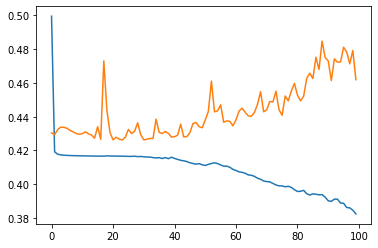

In [11]:
# 训练模型
checkPointSavedModelName = 'model_{epoch:02d}.h5'
checkPoint = ModelCheckpoint(
    filepath=checkPointSavedModelName,
    monitor='val_loss', 
    save_best_only=True)

ae.fit(x_train, 
    y_train,
    epochs=100,
    batch_size=batch_size,
    shuffle=False,
    validation_split=0.1,
    callbacks=[checkPoint]
    )

# plot
plt.plot(ae.history.history["loss"])
plt.plot(ae.history.history["val_loss"])


"""
# plot
plt.plot(preTrained_AE.history.history["loss"])
plt.plot(preTrained_AE.history.history["val_loss"])
"""

In [14]:
from skimage import data, img_as_float
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import mean_squared_error

def imgPredictionEvaluate(realImg_array, predictImg_array):

  mse_2img = mean_squared_error(realImg_array, predictImg_array)
  ssim_val_2img = ssim(realImg_array, predictImg_array, multichannel=True)

  evaluations = [round(mse_2img, 4), round(ssim_val_2img, 4)]
  return evaluations

1/1 [==============================] - 1s 827ms/step


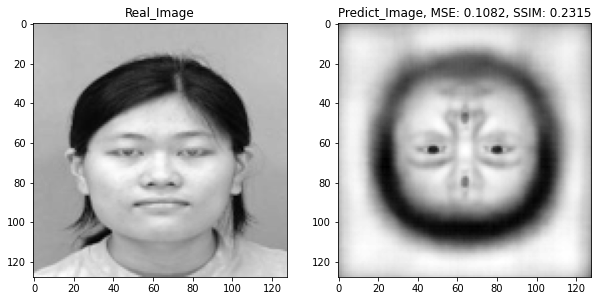

1/1 [==============================] - 0s 21ms/step


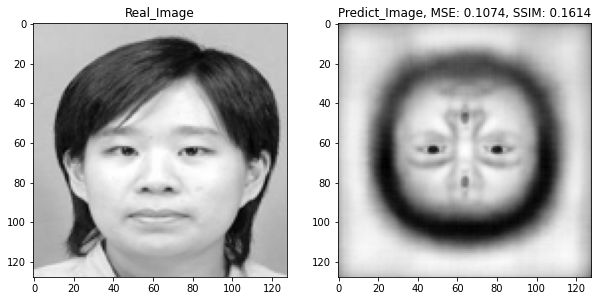

1/1 [==============================] - 0s 21ms/step


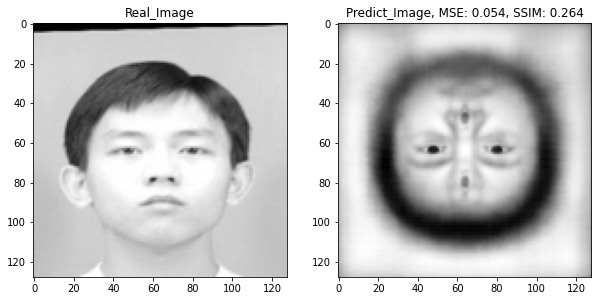

1/1 [==============================] - 0s 20ms/step


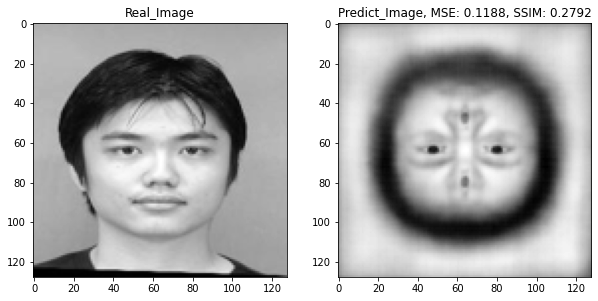

1/1 [==============================] - 0s 21ms/step


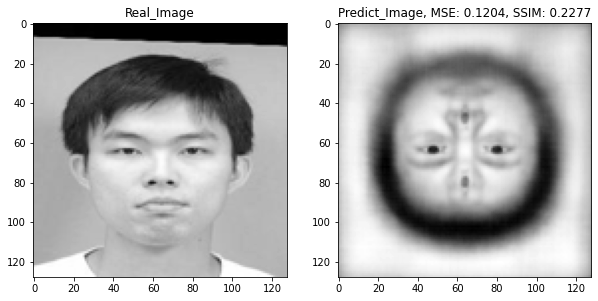

1/1 [==============================] - 0s 20ms/step


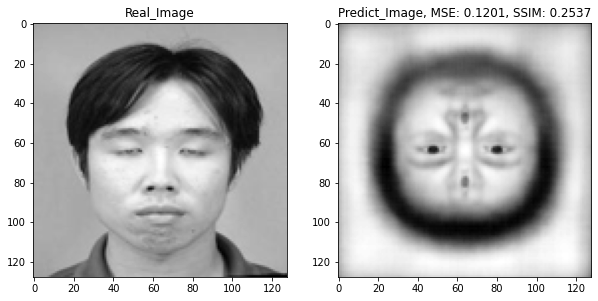

1/1 [==============================] - 0s 20ms/step


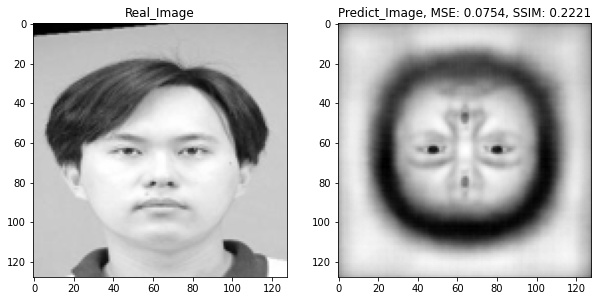

1/1 [==============================] - 0s 20ms/step


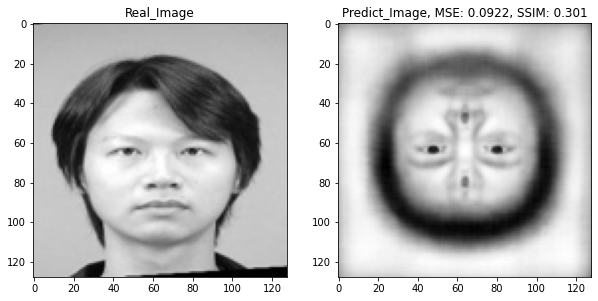

1/1 [==============================] - 0s 20ms/step


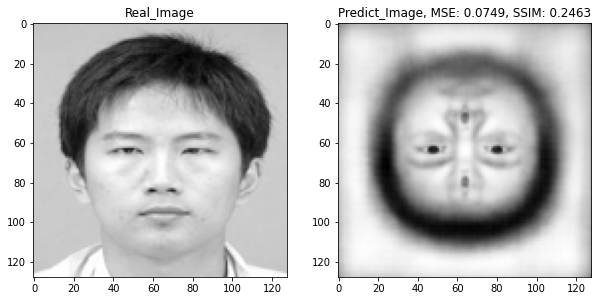

1/1 [==============================] - 0s 20ms/step


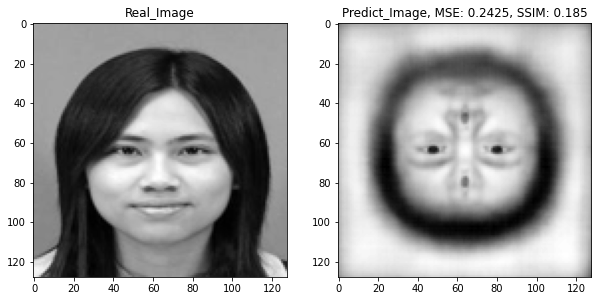

1/1 [==============================] - 0s 21ms/step


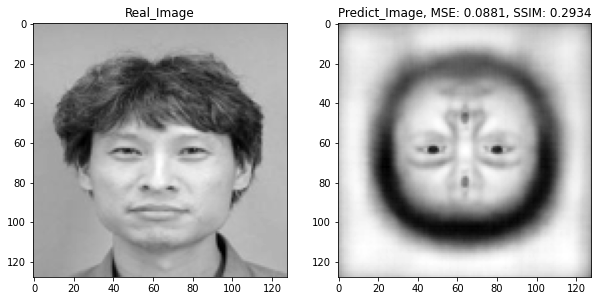

1/1 [==============================] - 0s 20ms/step


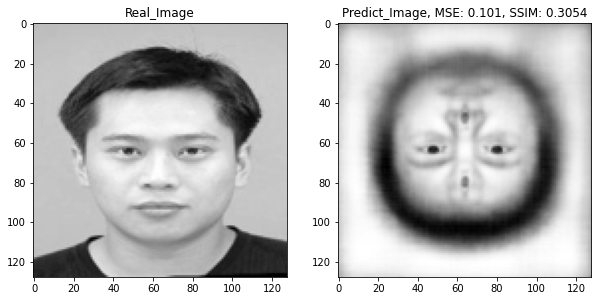

1/1 [==============================] - 0s 20ms/step


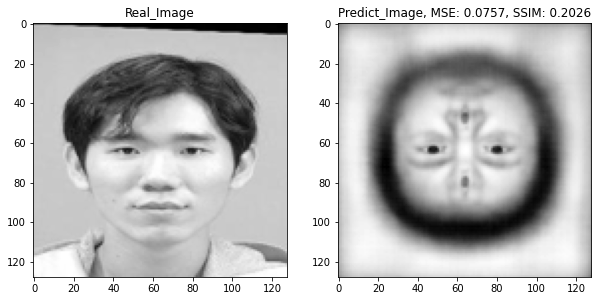

1/1 [==============================] - 0s 20ms/step


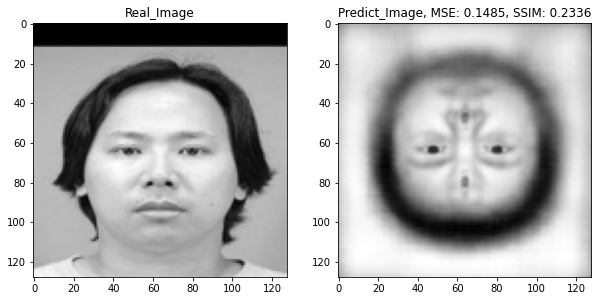

1/1 [==============================] - 0s 21ms/step


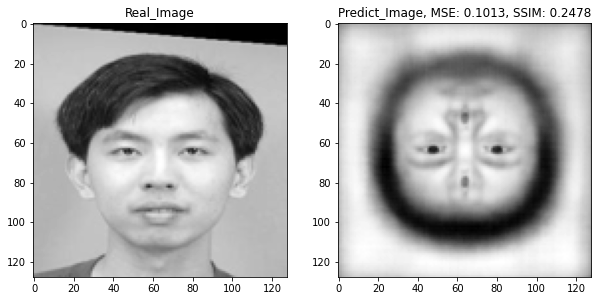

1/1 [==============================] - 0s 20ms/step


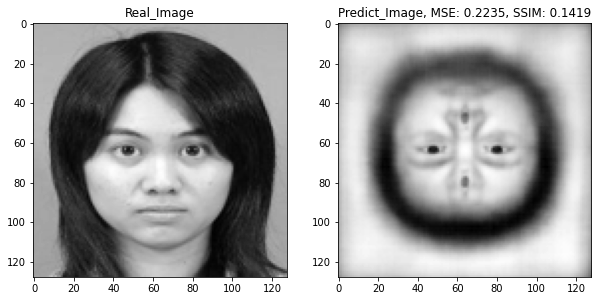

1/1 [==============================] - 0s 20ms/step


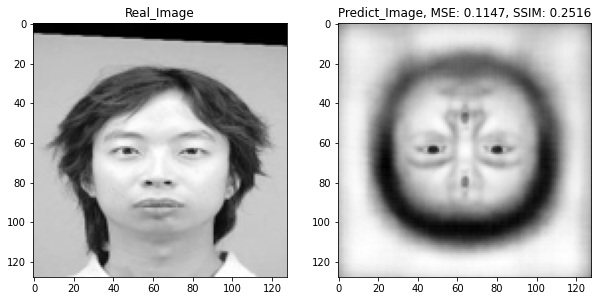

1/1 [==============================] - 0s 20ms/step


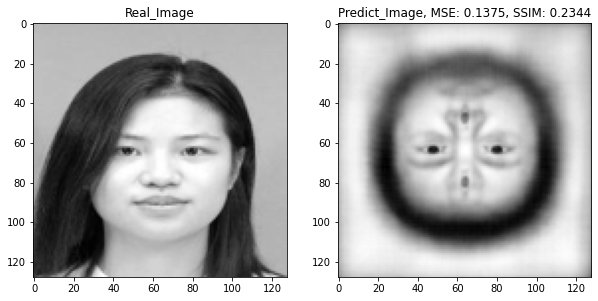

1/1 [==============================] - 0s 20ms/step


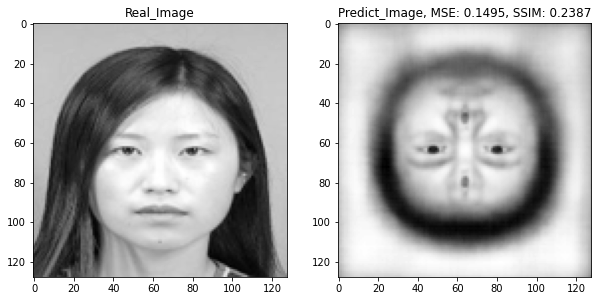

1/1 [==============================] - 0s 20ms/step


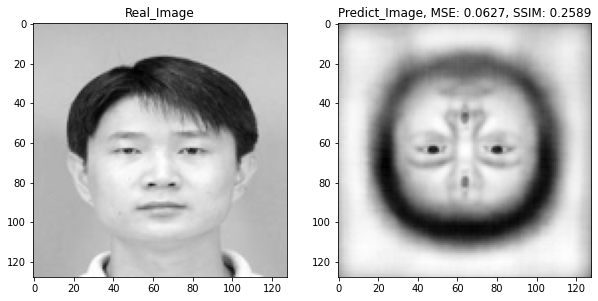

1/1 [==============================] - 0s 20ms/step


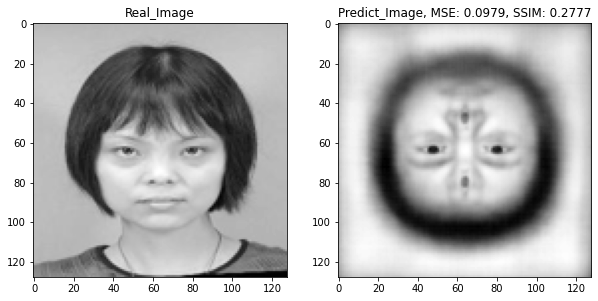

1/1 [==============================] - 0s 20ms/step


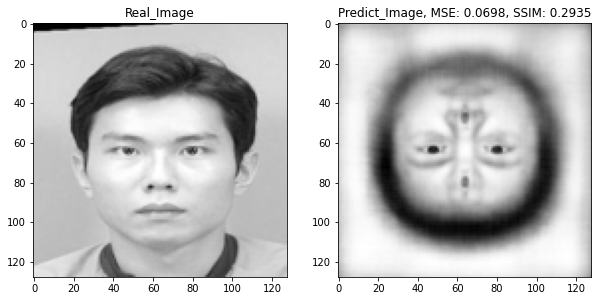

1/1 [==============================] - 0s 24ms/step


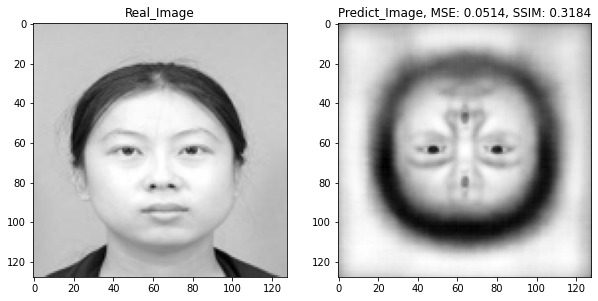

1/1 [==============================] - 0s 20ms/step


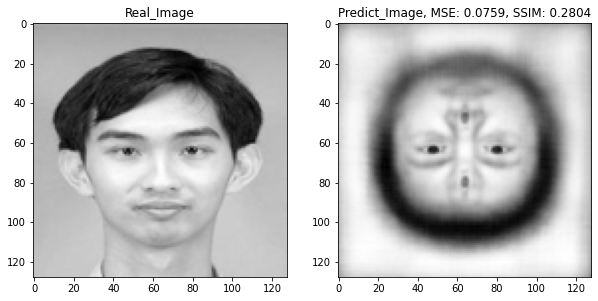

1/1 [==============================] - 0s 21ms/step


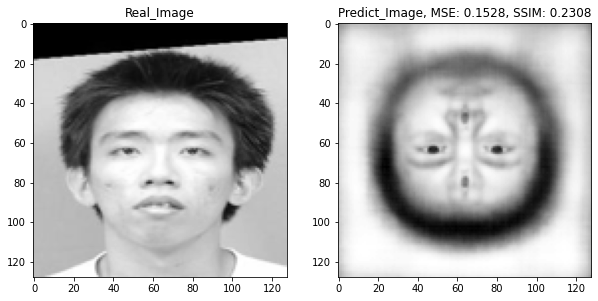

1/1 [==============================] - 0s 25ms/step


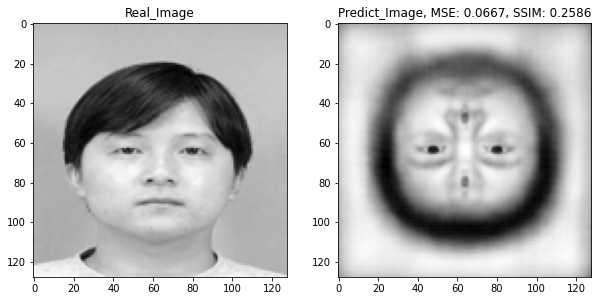

1/1 [==============================] - 0s 20ms/step


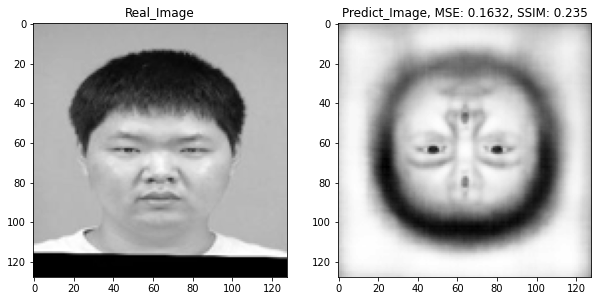

1/1 [==============================] - 0s 20ms/step


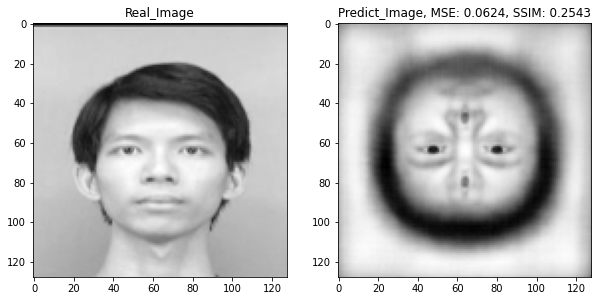

1/1 [==============================] - 0s 20ms/step


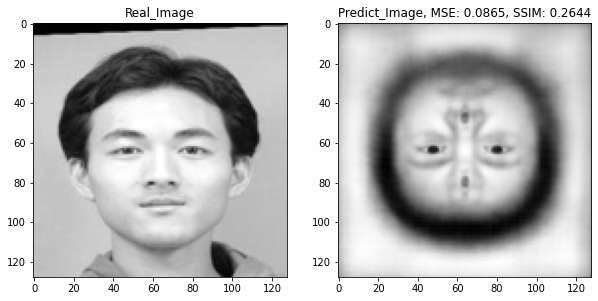

1/1 [==============================] - 0s 20ms/step


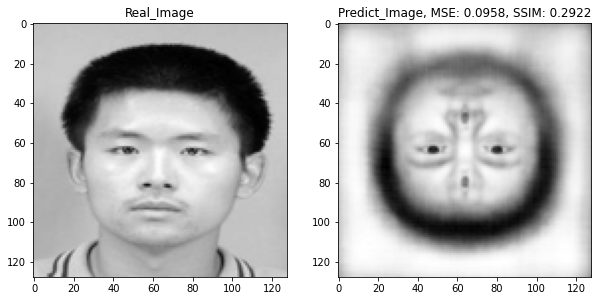

1/1 [==============================] - 0s 21ms/step


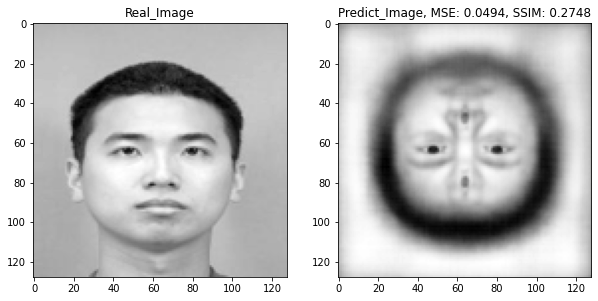

1/1 [==============================] - 0s 21ms/step


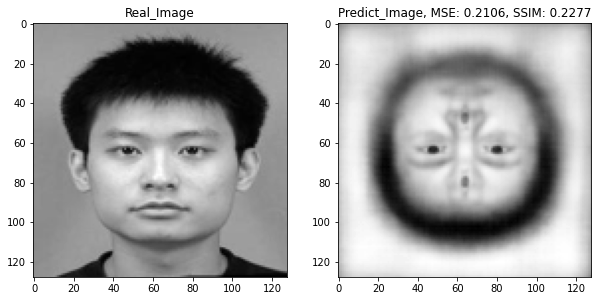

1/1 [==============================] - 0s 21ms/step


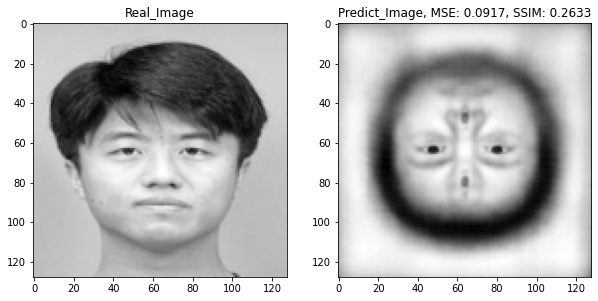

1/1 [==============================] - 0s 21ms/step


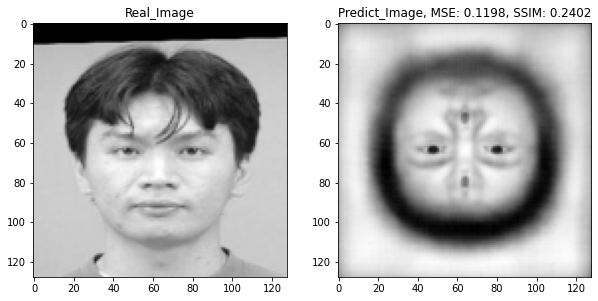

1/1 [==============================] - 0s 20ms/step


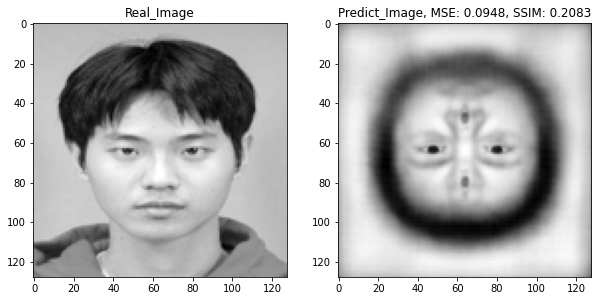

1/1 [==============================] - 0s 23ms/step


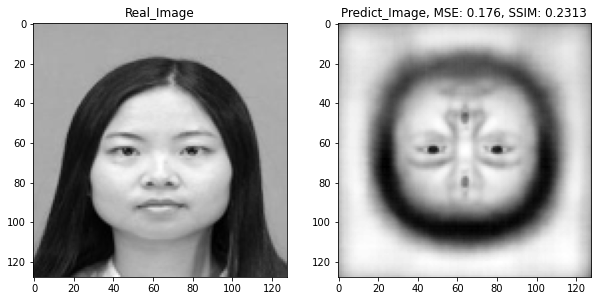

1/1 [==============================] - 0s 21ms/step


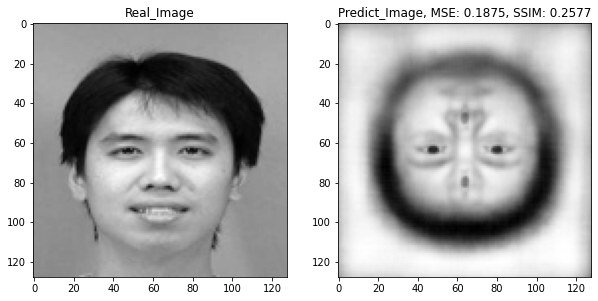

1/1 [==============================] - 0s 21ms/step


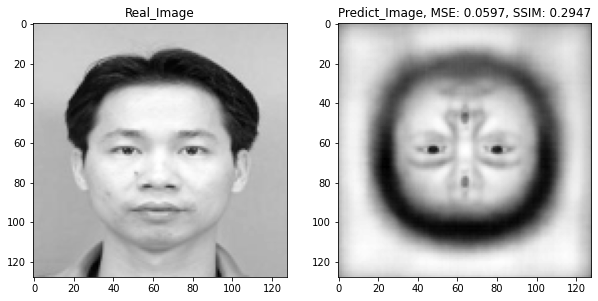

1/1 [==============================] - 0s 21ms/step


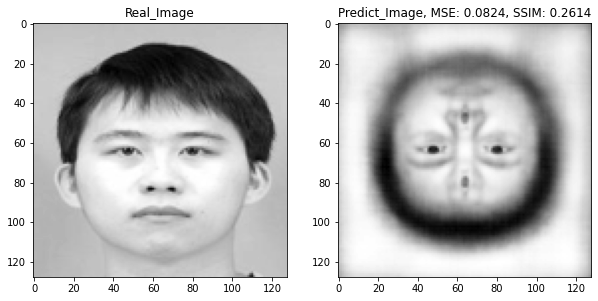

1/1 [==============================] - 0s 20ms/step


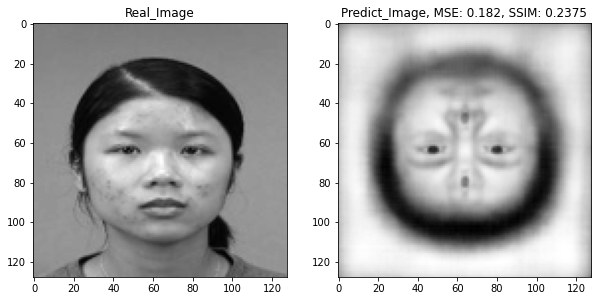

1/1 [==============================] - 0s 21ms/step


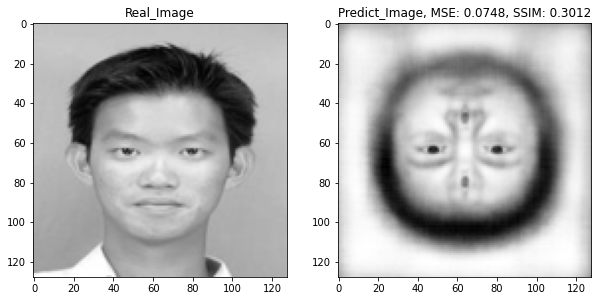

1/1 [==============================] - 0s 20ms/step


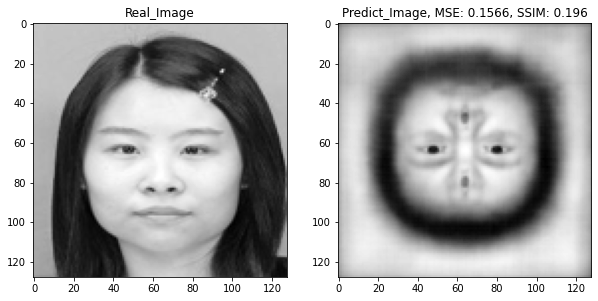

1/1 [==============================] - 0s 21ms/step


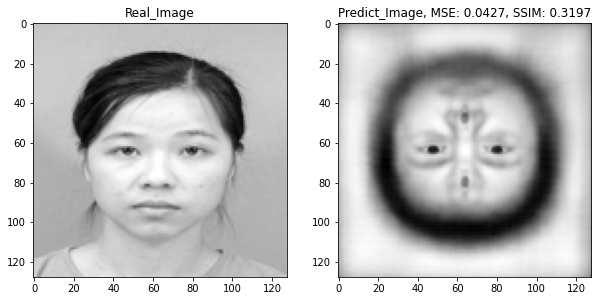

1/1 [==============================] - 0s 21ms/step


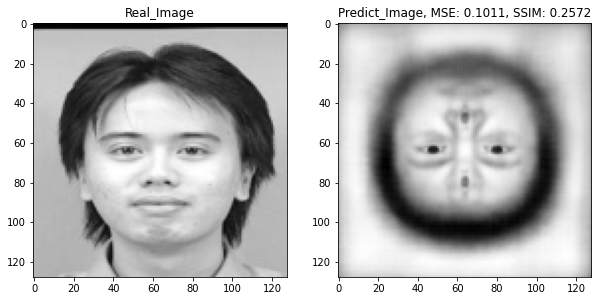

1/1 [==============================] - 0s 21ms/step


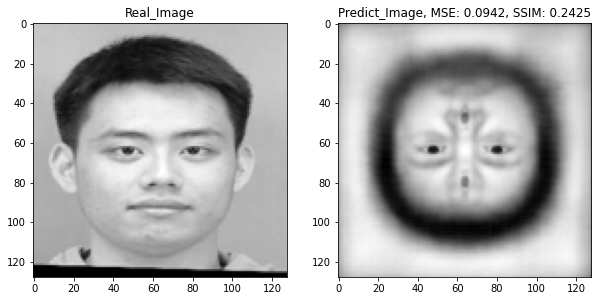

1/1 [==============================] - 0s 21ms/step


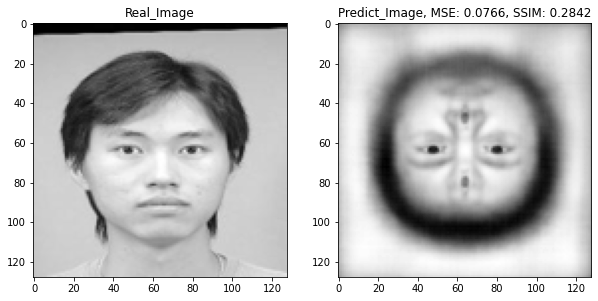

1/1 [==============================] - 0s 22ms/step


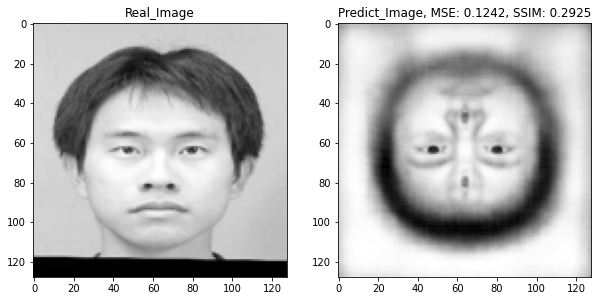

1/1 [==============================] - 0s 22ms/step


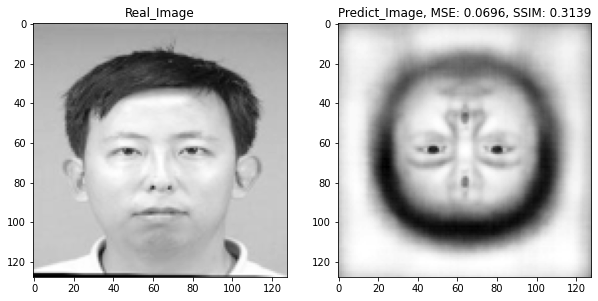

1/1 [==============================] - 0s 23ms/step


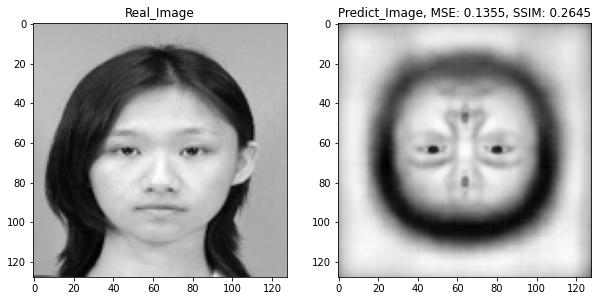

1/1 [==============================] - 0s 23ms/step


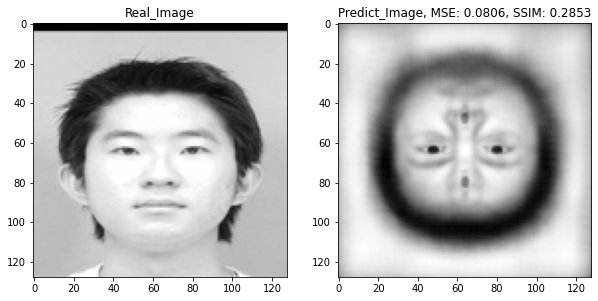

1/1 [==============================] - 0s 21ms/step


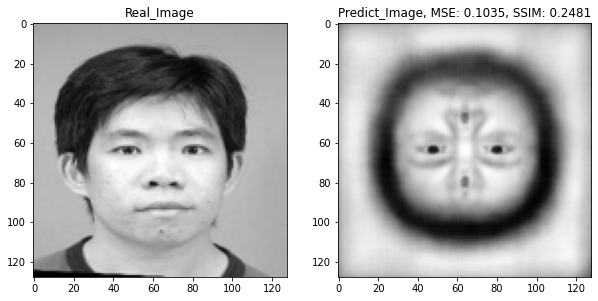

1/1 [==============================] - 0s 30ms/step


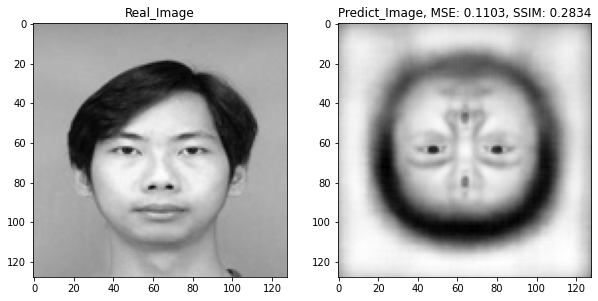

1/1 [==============================] - 0s 25ms/step


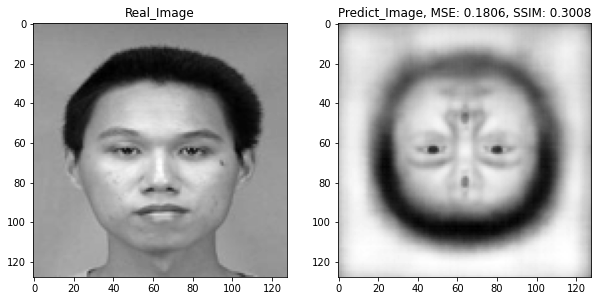

1/1 [==============================] - 0s 26ms/step


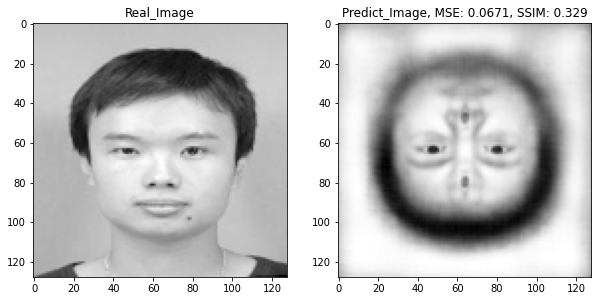

1/1 [==============================] - 0s 23ms/step


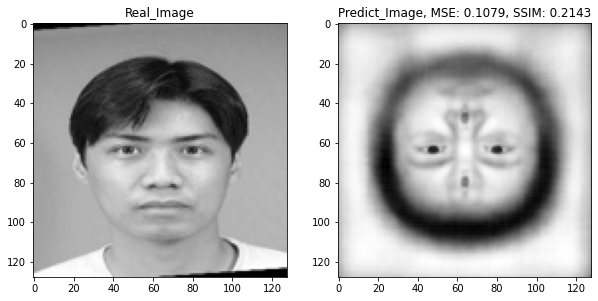

1/1 [==============================] - 0s 23ms/step


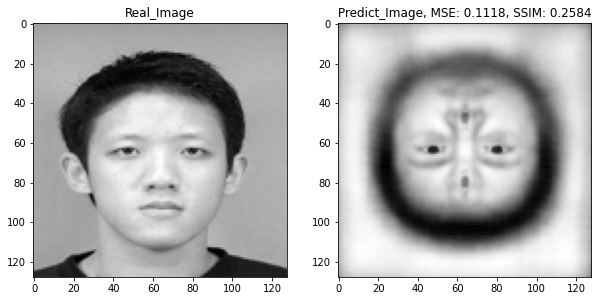

1/1 [==============================] - 0s 23ms/step


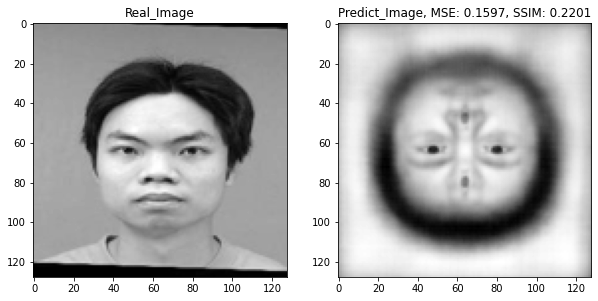

1/1 [==============================] - 0s 21ms/step


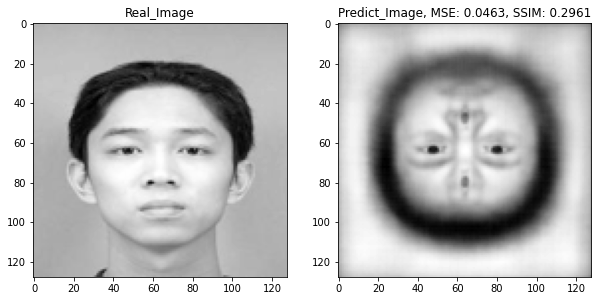

1/1 [==============================] - 0s 23ms/step


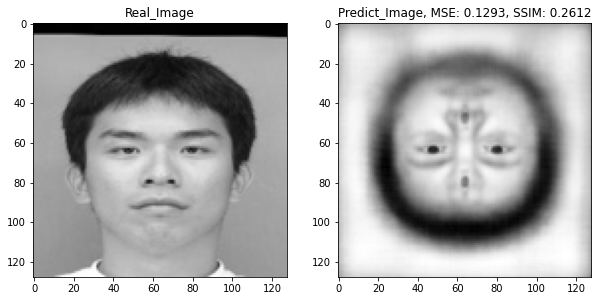

1/1 [==============================] - 0s 20ms/step


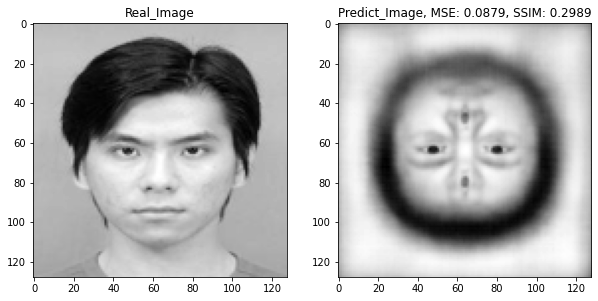

1/1 [==============================] - 0s 22ms/step


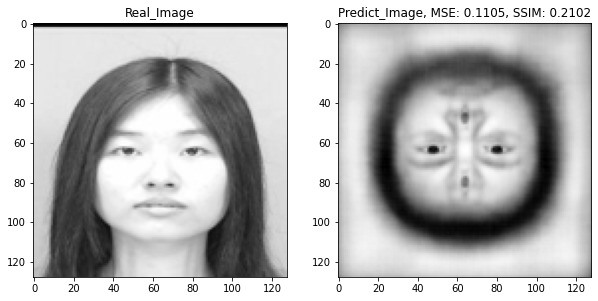

1/1 [==============================] - 0s 20ms/step


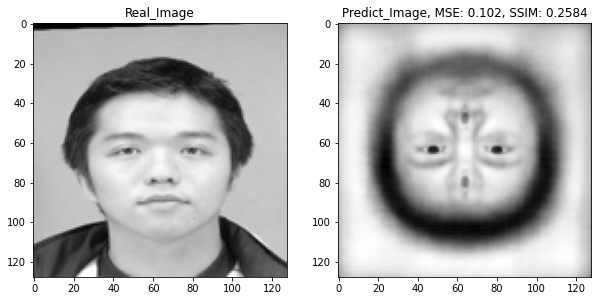

1/1 [==============================] - 0s 21ms/step


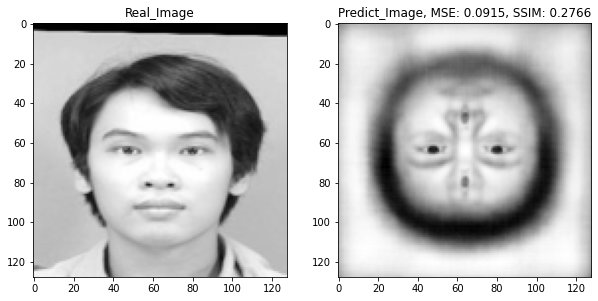

1/1 [==============================] - 0s 22ms/step


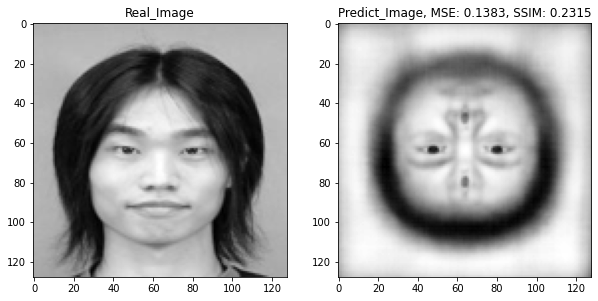

1/1 [==============================] - 0s 20ms/step


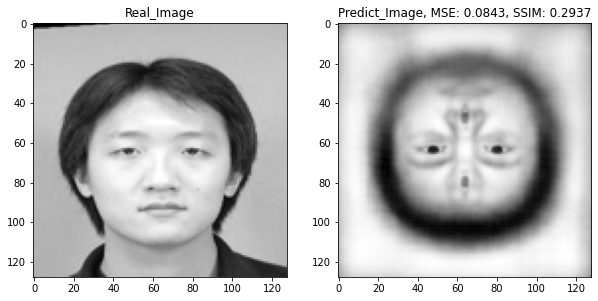

1/1 [==============================] - 0s 22ms/step


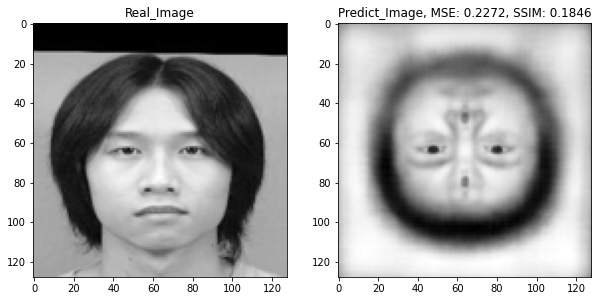

1/1 [==============================] - 0s 23ms/step


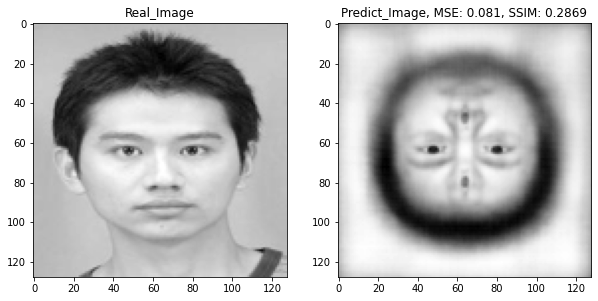

1/1 [==============================] - 0s 22ms/step


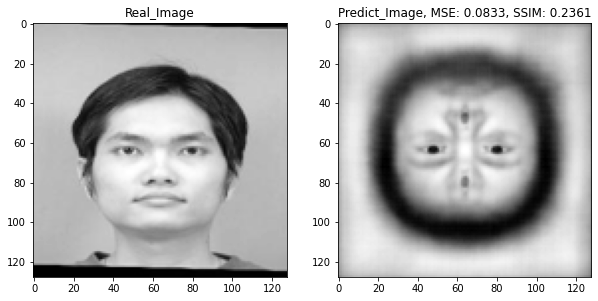

1/1 [==============================] - 0s 24ms/step


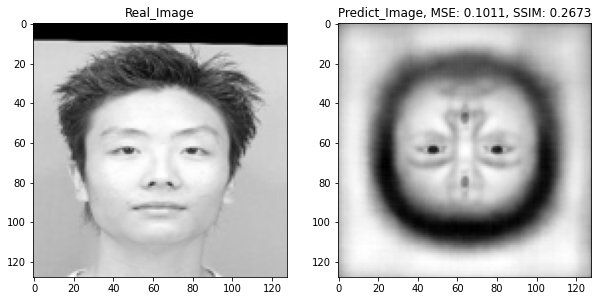

1/1 [==============================] - 0s 23ms/step


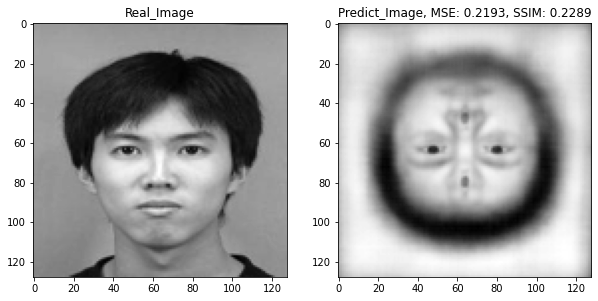

1/1 [==============================] - 0s 21ms/step


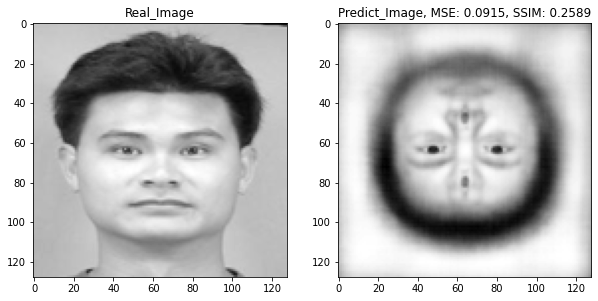

1/1 [==============================] - 0s 22ms/step


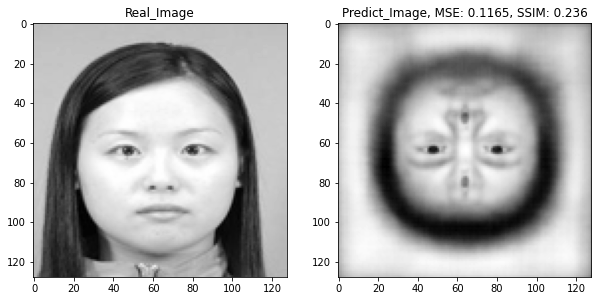

1/1 [==============================] - 0s 26ms/step


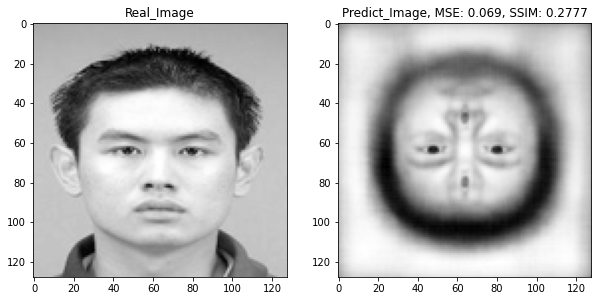

1/1 [==============================] - 0s 23ms/step


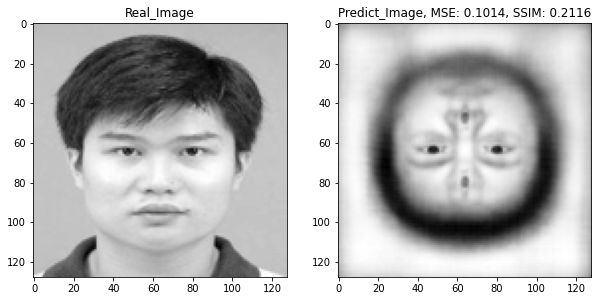

1/1 [==============================] - 0s 24ms/step


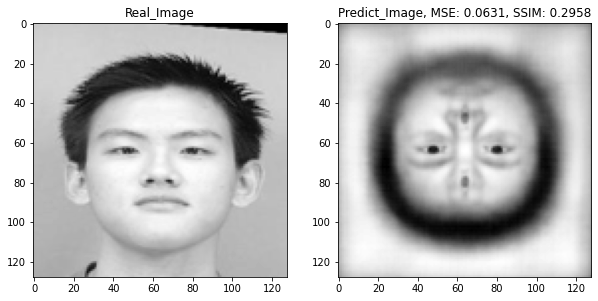

1/1 [==============================] - 0s 22ms/step


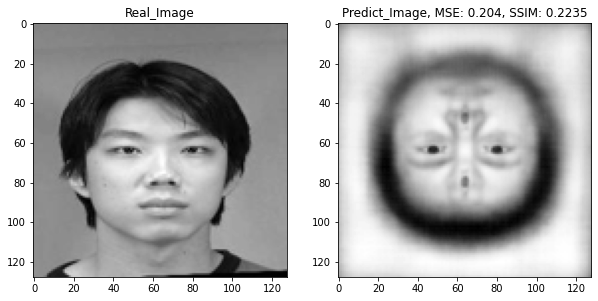

1/1 [==============================] - 0s 21ms/step


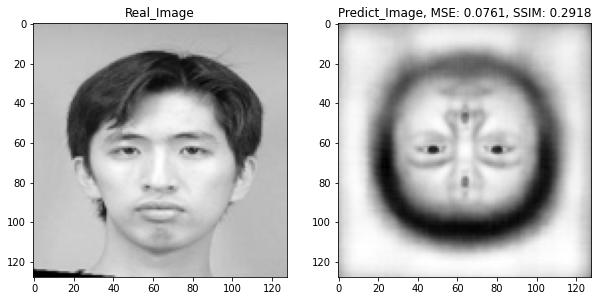

1/1 [==============================] - 0s 26ms/step


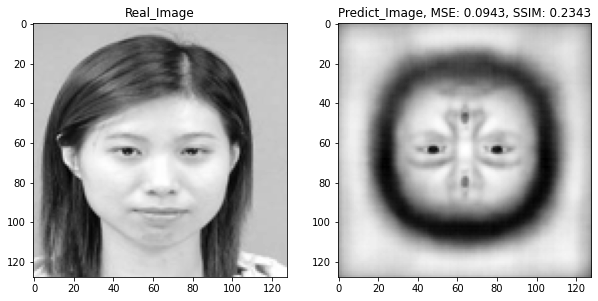

1/1 [==============================] - 0s 29ms/step


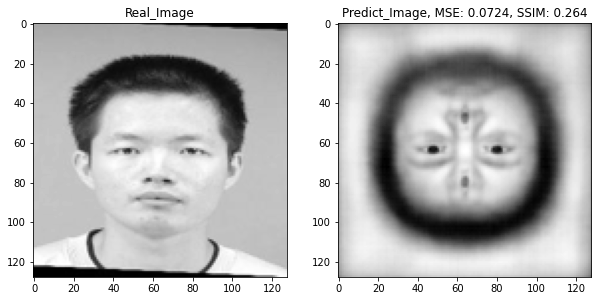

1/1 [==============================] - 0s 20ms/step


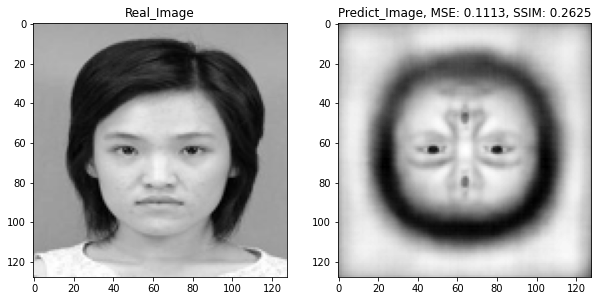

1/1 [==============================] - 0s 22ms/step


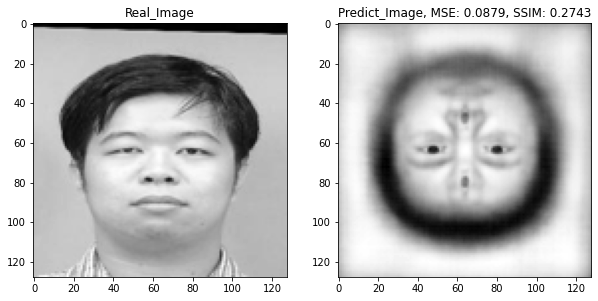

1/1 [==============================] - 0s 28ms/step


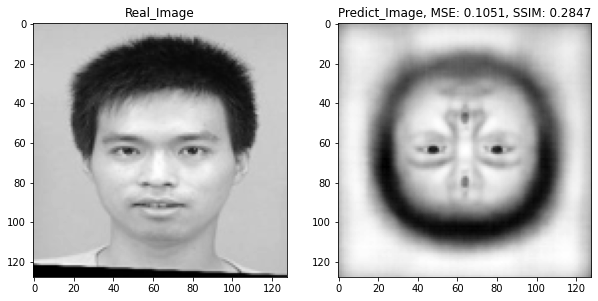

1/1 [==============================] - 0s 23ms/step


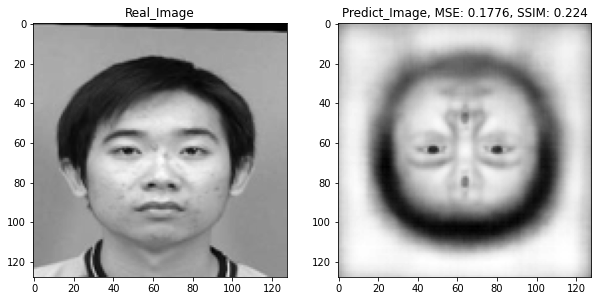

1/1 [==============================] - 0s 22ms/step


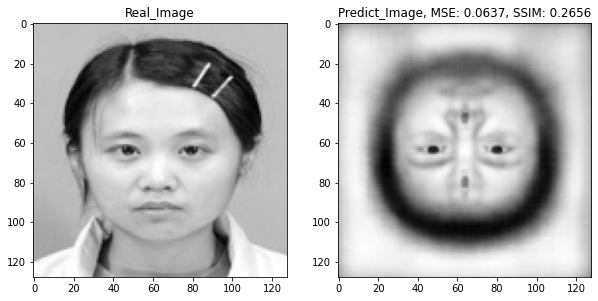

1/1 [==============================] - 0s 23ms/step


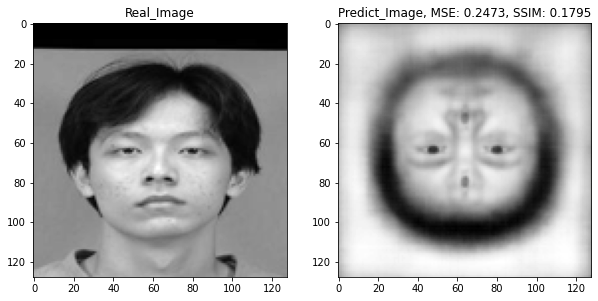

1/1 [==============================] - 0s 22ms/step


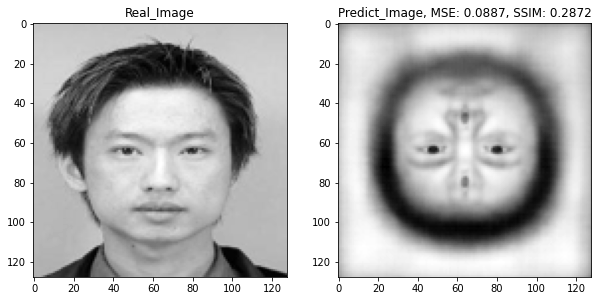

1/1 [==============================] - 0s 23ms/step


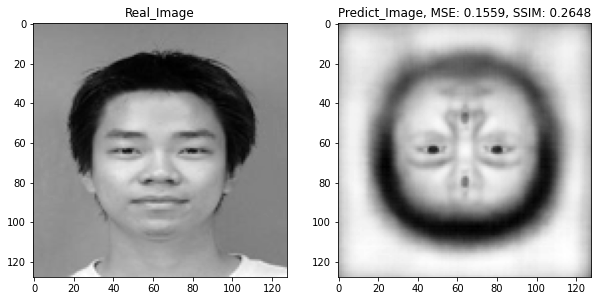

1/1 [==============================] - 0s 23ms/step


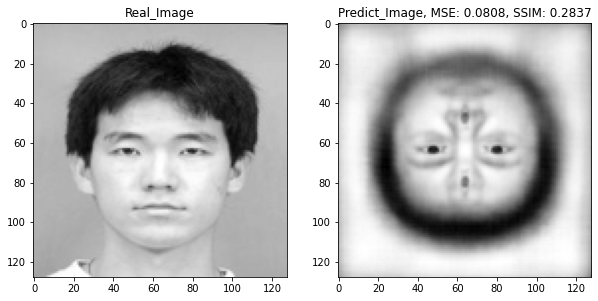

1/1 [==============================] - 0s 22ms/step


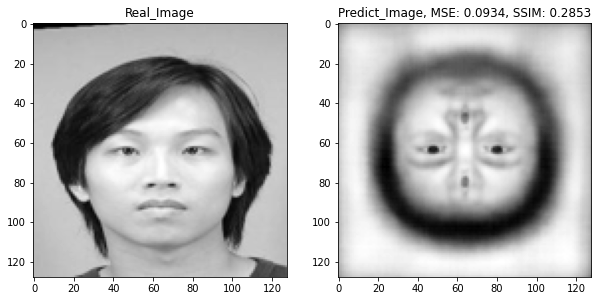

1/1 [==============================] - 0s 21ms/step


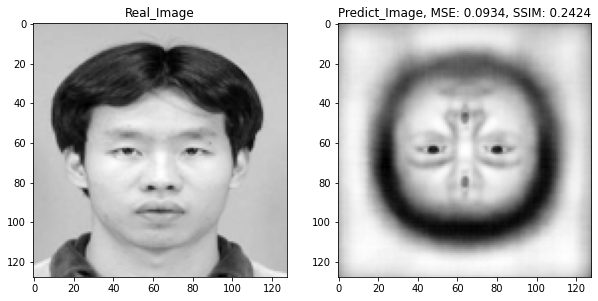

1/1 [==============================] - 0s 22ms/step


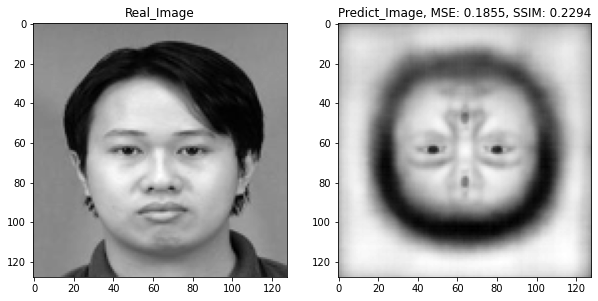

1/1 [==============================] - 0s 22ms/step


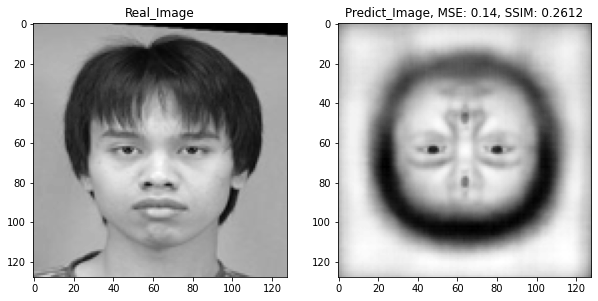

1/1 [==============================] - 0s 22ms/step


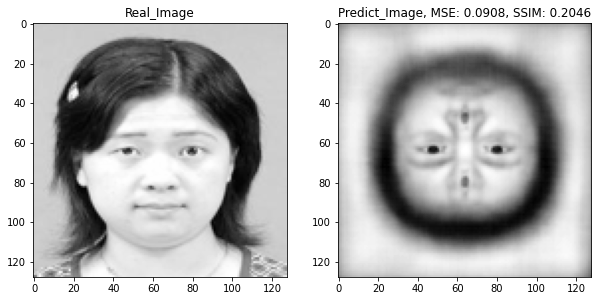

1/1 [==============================] - 0s 22ms/step


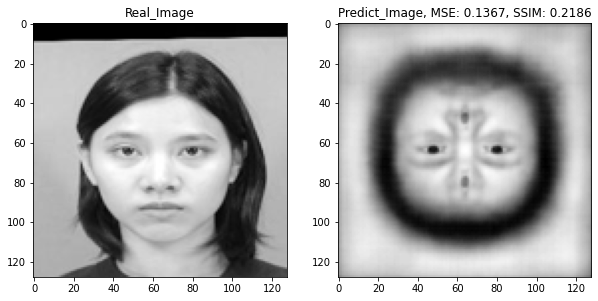

1/1 [==============================] - 0s 24ms/step


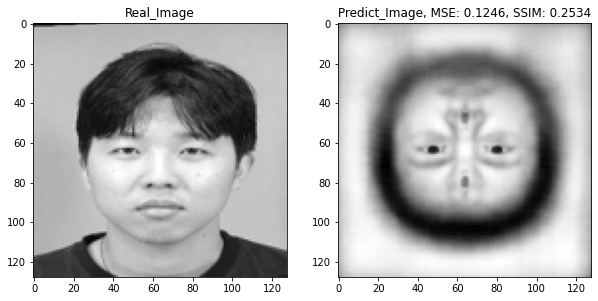

1/1 [==============================] - 0s 24ms/step


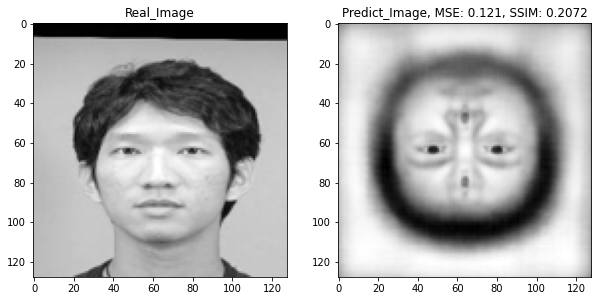

1/1 [==============================] - 0s 21ms/step


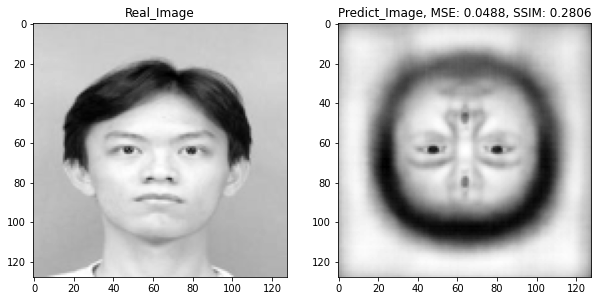

1/1 [==============================] - 0s 23ms/step


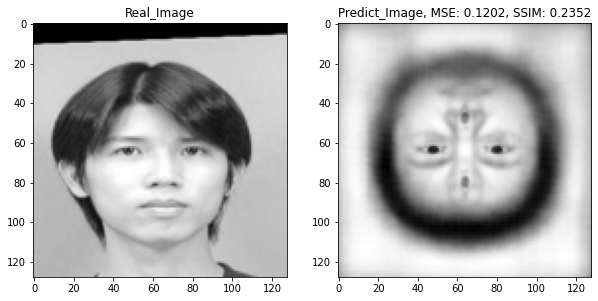

1/1 [==============================] - 0s 29ms/step


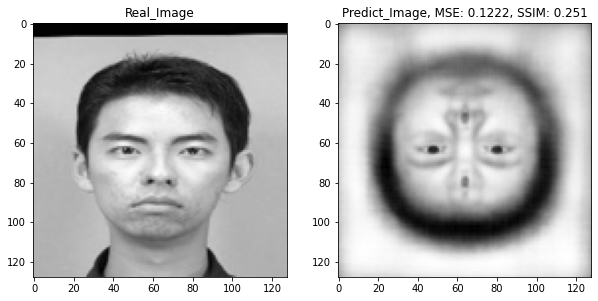

1/1 [==============================] - 0s 30ms/step


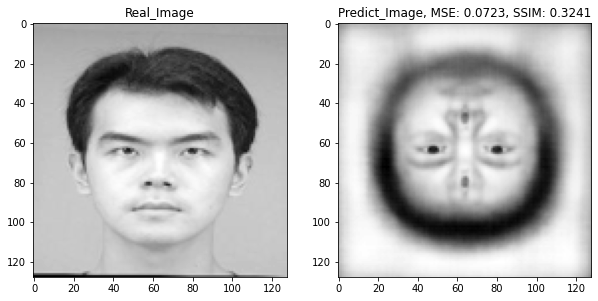

The overall MSE analysis of test dataset: Mean:0.1115, Max:0.2473, Min:0.0427
The overall SSIM analysis of test dataset: Mean:0.2554, Max:0.329, Min:0.1419


In [ ]:
# Store all test cases' evaluations
MSE_all = []
SSIM_all = []
# 使用VAE模型生成素描图片
for fileName in os.listdir(filePath3):
    # 读取输入图片
    image_tmp = Image.open(os.path.join(filePath3, fileName)).convert('L')
    
    # 转换为模型的输入格式
    image_tmp = image_tmp.resize((128, 128))
    img_tmp = np.array(image_tmp).reshape((1,128,128,1)).astype('float32') / 255.

    # 使用VAE模型生成素描图片
#    z_mean,_ = encoder.predict(img_tmp)
#    sketch_img = decoder.predict(x=z_mean)
    sketch_img = ae.predict(img_tmp)

    # 转换为PIL Image格式并保存为文件
    sketch_img = sketch_img[0] * 255.
    #sketch_img = np.clip(sketch_img, 0, 255).astype('uint8')
    sketch_img = sketch_img.astype('uint8').reshape((*sketch_img.shape[:-1],))
    sketch_img = Image.fromarray(sketch_img)

    # Calculate MSE and SSIM of predict Image
    evaluations_tmp = imgPredictionEvaluate(realImg = image_tmp, predictImg = sketch_img)
    mse_tmp = evaluations_tmp[0]
    ssim_tmp = evaluations_tmp[1]
    MSE_all.append(mse_tmp)
    SSIM_all.append(ssim_tmp)
    # 显示生成的素描图片
    plt.figure(figsize = (10,10))
    plt.subplot(1,2,1)
    plt.title('Real_Image')
    plt.imshow(image_tmp, cmap = 'gray')
    plt.subplot(1,2,2)
    name = 'Predict_Image, MSE: {}, SSIM: {}'.format(mse_tmp, ssim_tmp)
    plt.title(name)
    plt.imshow(sketch_img, cmap = 'gray')
    plt.show()

# calculate the overall MSE & SSIM
MSE_all_Mean = round(np.mean(MSE_all), 4)
MSE_all_Max = np.max(MSE_all)
MSE_all_Min = np.min(MSE_all)

SSIM_all_Mean = round(np.mean(SSIM_all), 4)
SSIM_all_Max = np.max(SSIM_all)
SSIM_all_Min = np.min(SSIM_all) 

print('The overall MSE analysis of test dataset: Mean:{}, Max:{}, Min:{}'.format(MSE_all_Mean, MSE_all_Max, MSE_all_Min))
print('The overall SSIM analysis of test dataset: Mean:{}, Max:{}, Min:{}'.format(SSIM_all_Mean, SSIM_all_Max, SSIM_all_Min))

1/1 [==============================] - 0s 20ms/step


<ipython-input-14-edbfa198a007>:8: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim_val_2img = ssim(realImg_array, predictImg_array, multichannel=True)


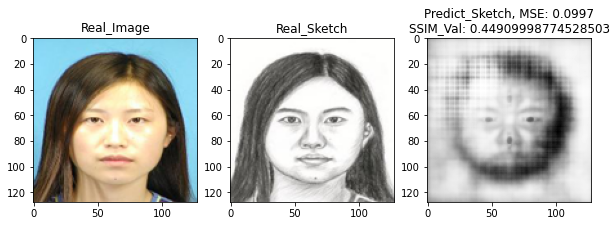

1/1 [==============================] - 0s 20ms/step


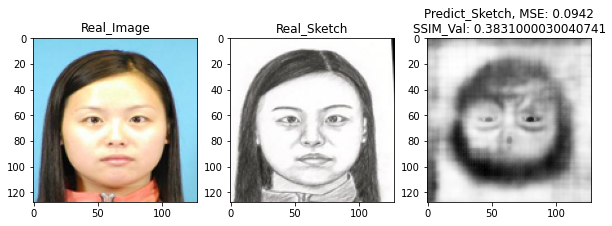

1/1 [==============================] - 0s 20ms/step


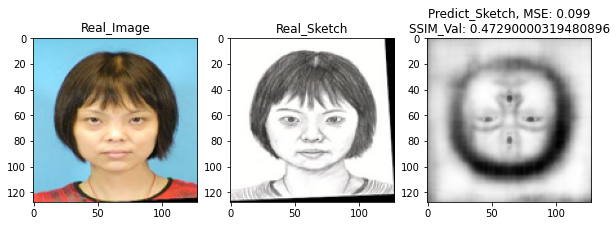

1/1 [==============================] - 0s 26ms/step


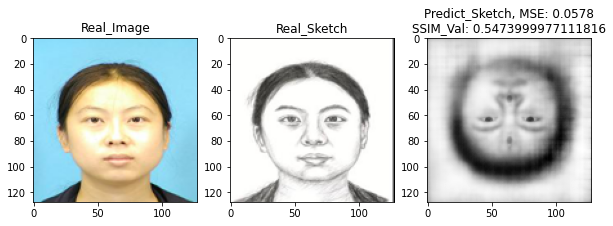

1/1 [==============================] - 0s 20ms/step


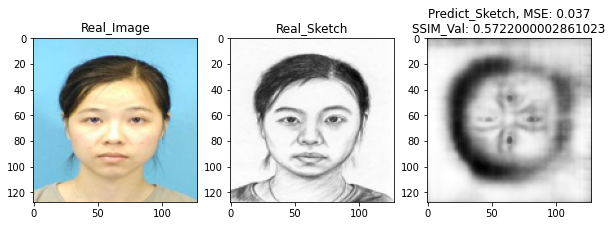

1/1 [==============================] - 0s 23ms/step


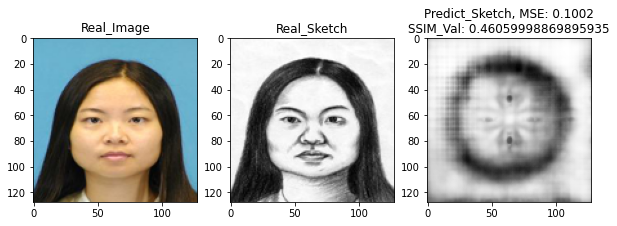

1/1 [==============================] - 0s 19ms/step


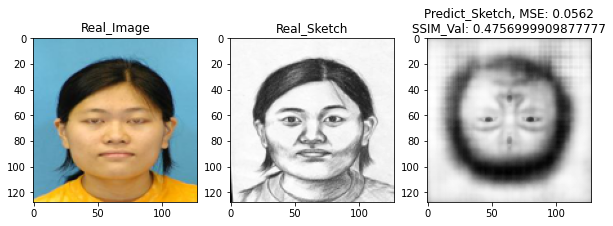

1/1 [==============================] - 0s 21ms/step


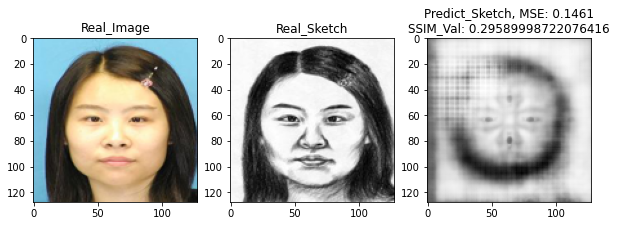

1/1 [==============================] - 0s 19ms/step


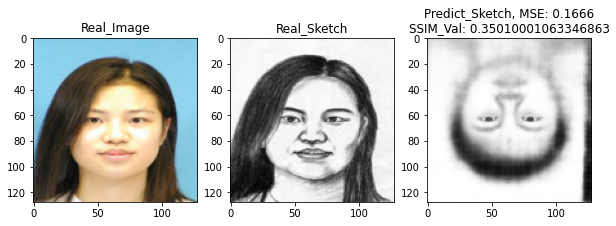

1/1 [==============================] - 0s 19ms/step


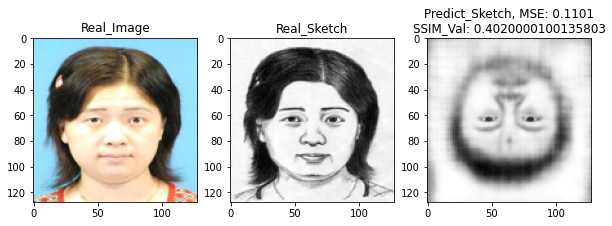

1/1 [==============================] - 0s 21ms/step


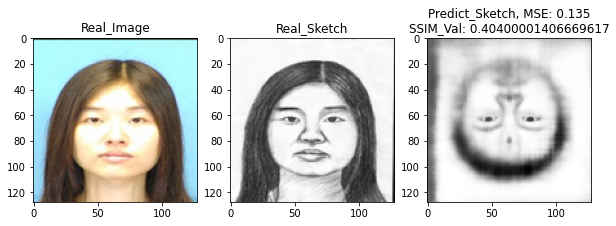

1/1 [==============================] - 0s 20ms/step


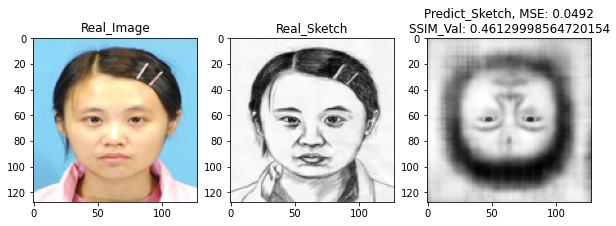

1/1 [==============================] - 0s 20ms/step


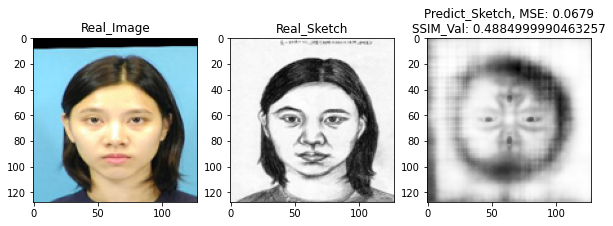

1/1 [==============================] - 0s 19ms/step


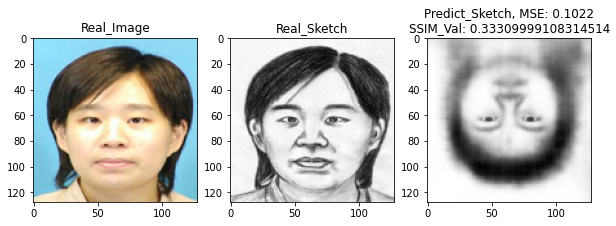

1/1 [==============================] - 0s 19ms/step


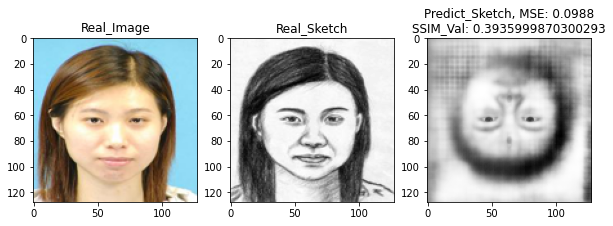

1/1 [==============================] - 0s 21ms/step


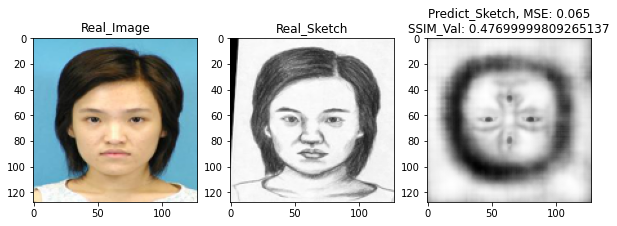

1/1 [==============================] - 0s 20ms/step


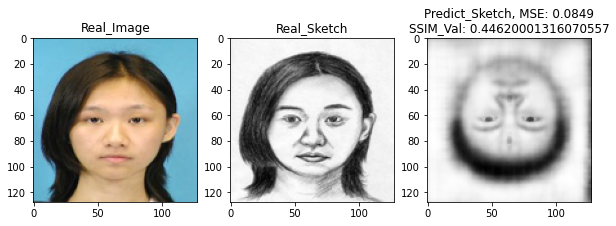

1/1 [==============================] - 0s 20ms/step


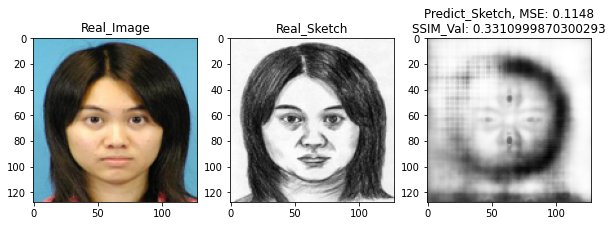

1/1 [==============================] - 0s 21ms/step


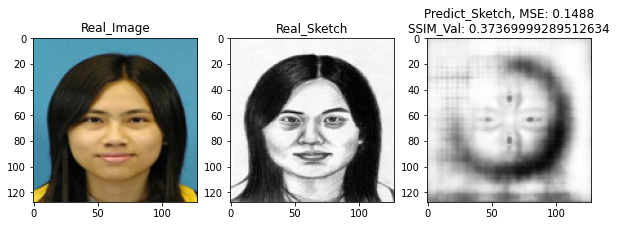

1/1 [==============================] - 0s 20ms/step


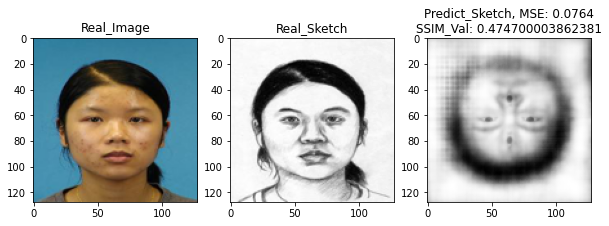

1/1 [==============================] - 0s 20ms/step


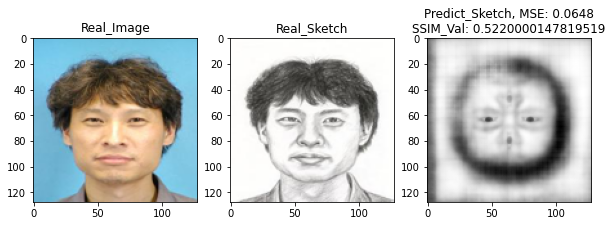

1/1 [==============================] - 0s 20ms/step


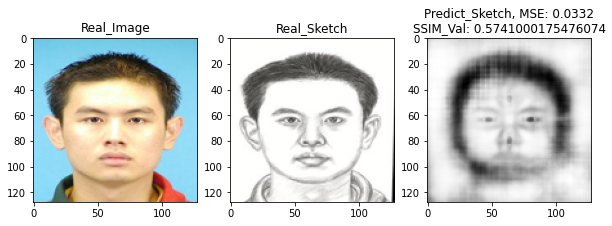

1/1 [==============================] - 0s 20ms/step


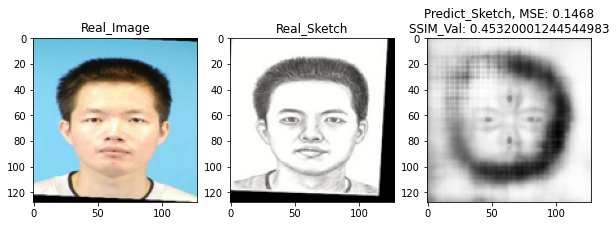

1/1 [==============================] - 0s 20ms/step


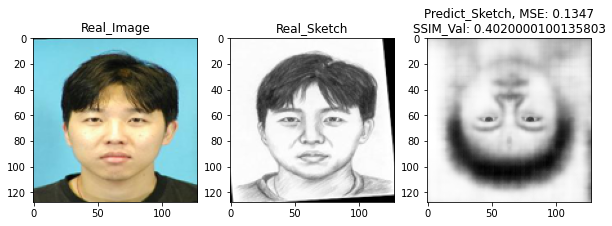

1/1 [==============================] - 0s 23ms/step


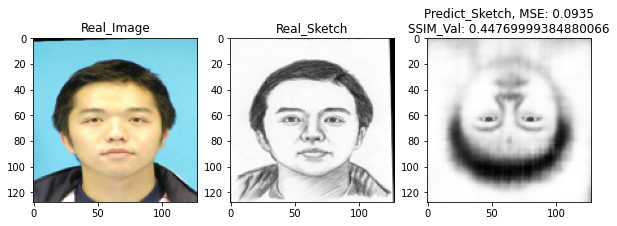

1/1 [==============================] - 0s 20ms/step


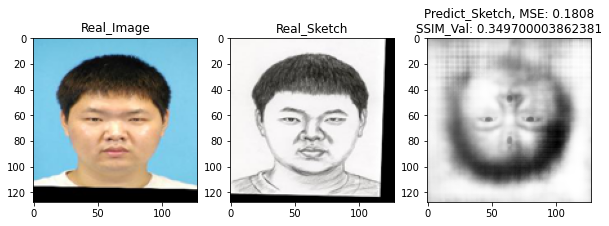

1/1 [==============================] - 0s 20ms/step


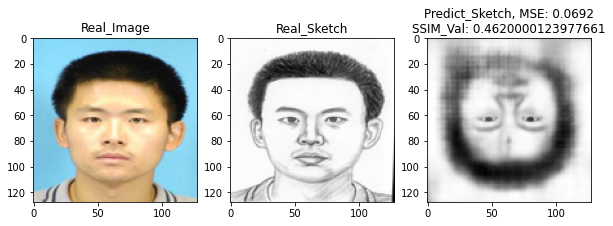

1/1 [==============================] - 0s 20ms/step


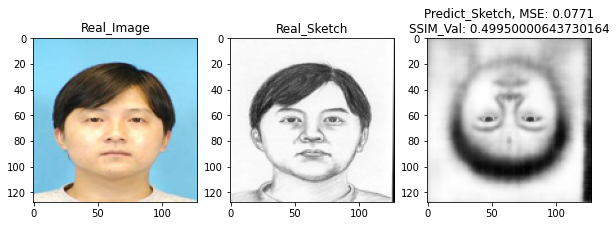

1/1 [==============================] - 0s 21ms/step


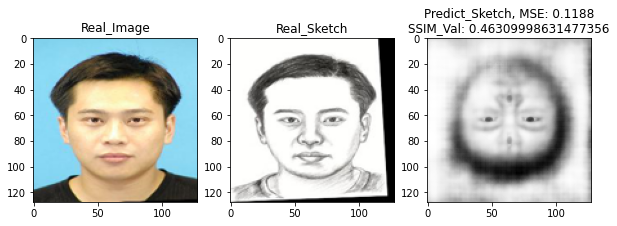

1/1 [==============================] - 0s 21ms/step


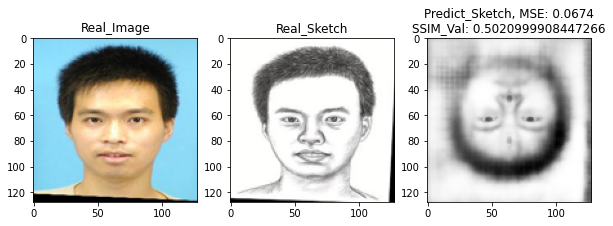

1/1 [==============================] - 0s 22ms/step


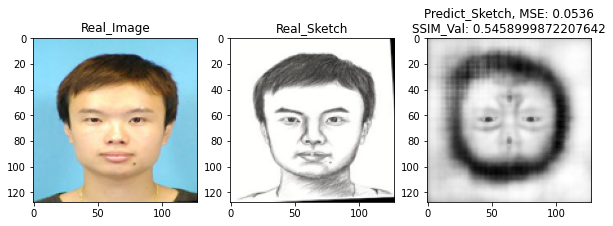

1/1 [==============================] - 0s 26ms/step


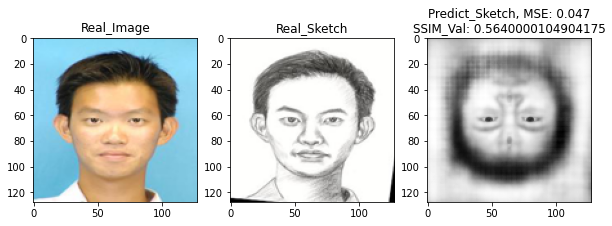

1/1 [==============================] - 0s 21ms/step


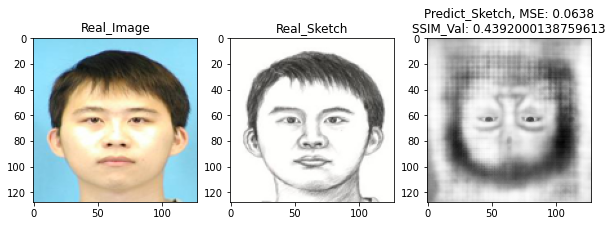

1/1 [==============================] - 0s 21ms/step


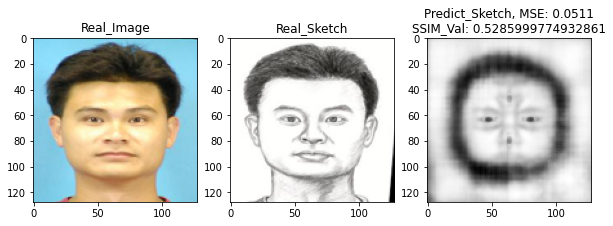

1/1 [==============================] - 0s 21ms/step


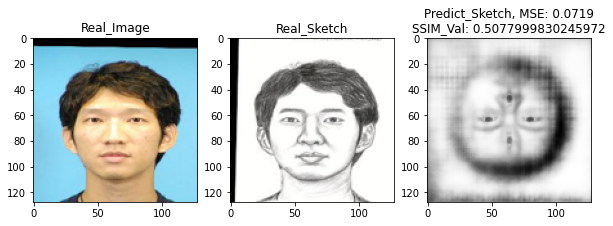

1/1 [==============================] - 0s 20ms/step


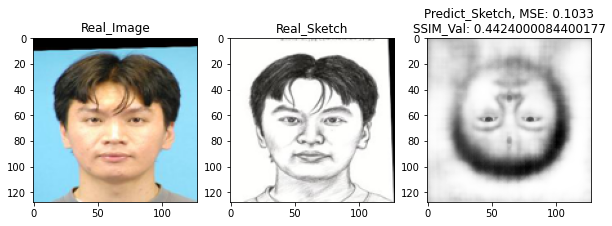

1/1 [==============================] - 0s 28ms/step


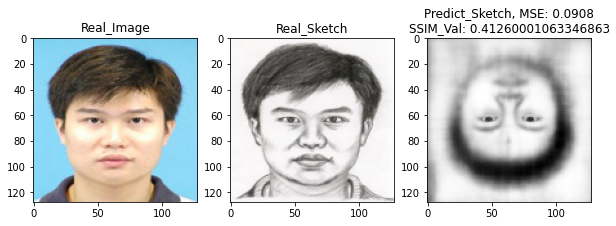

1/1 [==============================] - 0s 25ms/step


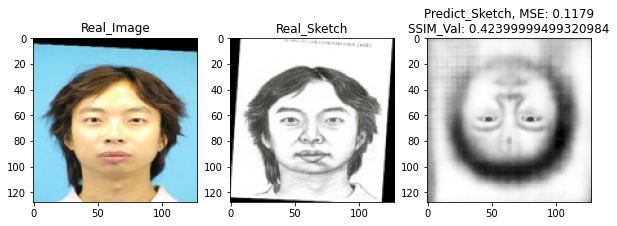

1/1 [==============================] - 0s 26ms/step


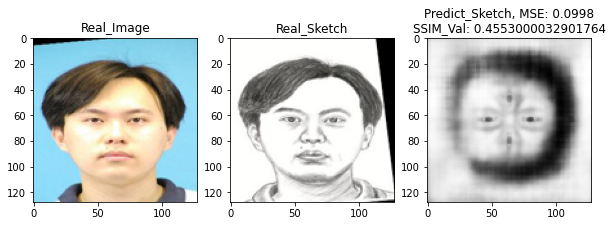

1/1 [==============================] - 0s 20ms/step


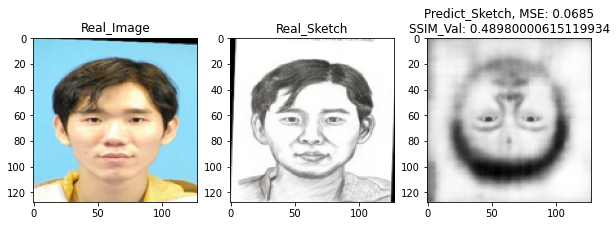

1/1 [==============================] - 0s 25ms/step


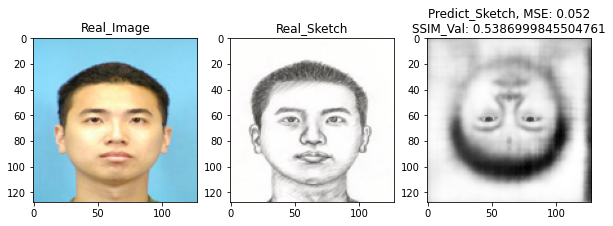

1/1 [==============================] - 0s 20ms/step


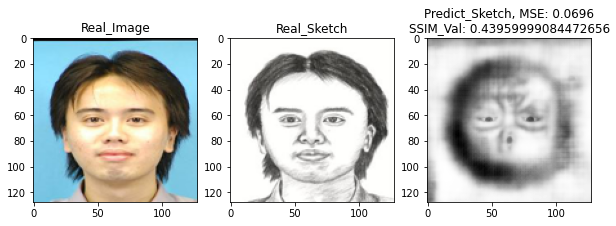

1/1 [==============================] - 0s 22ms/step


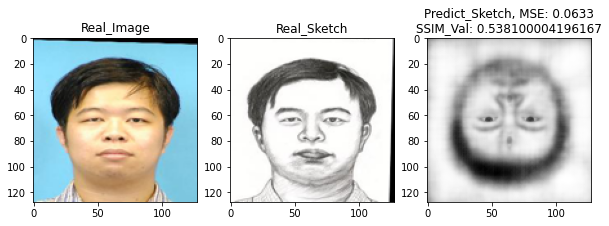

1/1 [==============================] - 0s 21ms/step


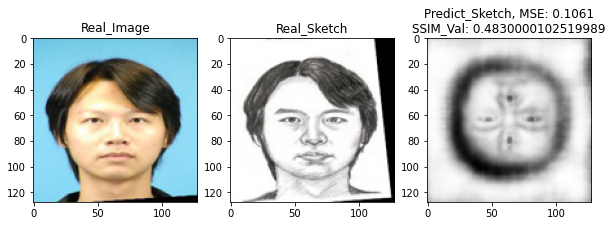

1/1 [==============================] - 0s 31ms/step


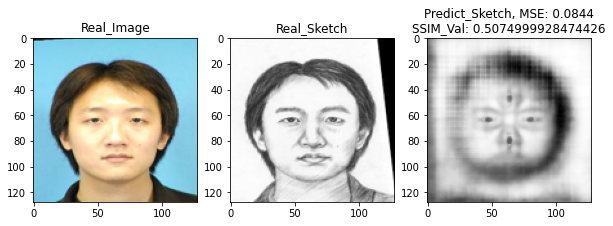

1/1 [==============================] - 0s 21ms/step


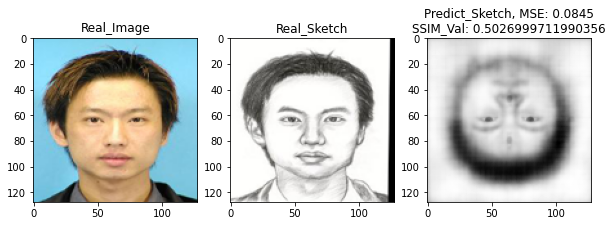

1/1 [==============================] - 0s 23ms/step


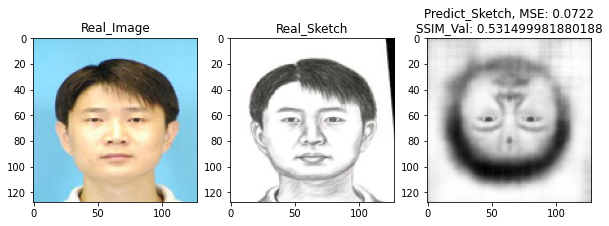

1/1 [==============================] - 0s 22ms/step


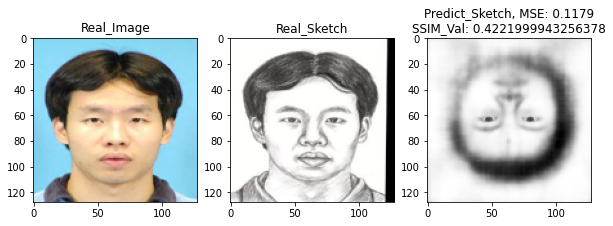

1/1 [==============================] - 0s 20ms/step


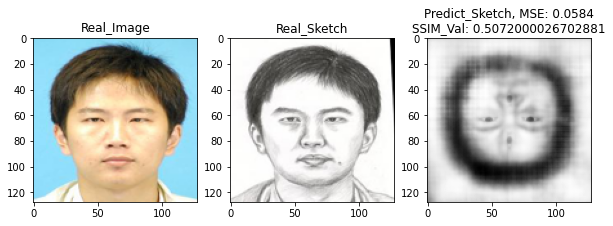

1/1 [==============================] - 0s 19ms/step


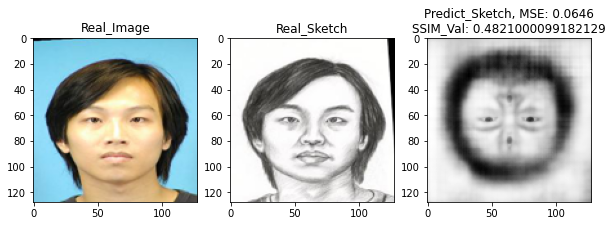

1/1 [==============================] - 0s 21ms/step


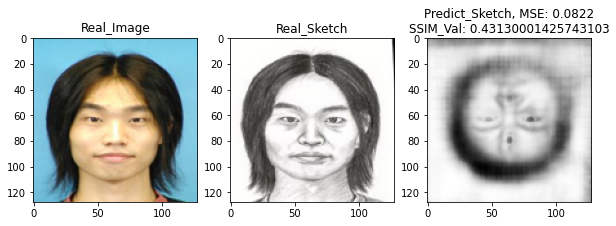

1/1 [==============================] - 0s 20ms/step


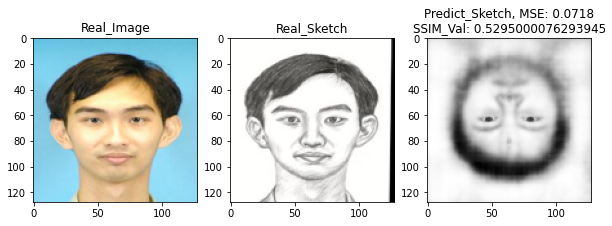

1/1 [==============================] - 0s 21ms/step


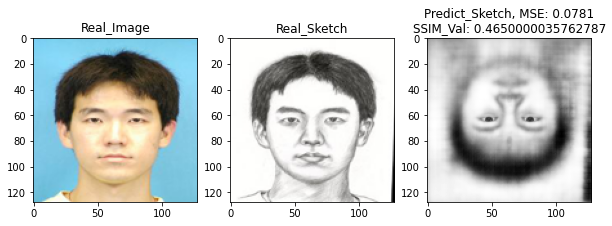

1/1 [==============================] - 0s 20ms/step


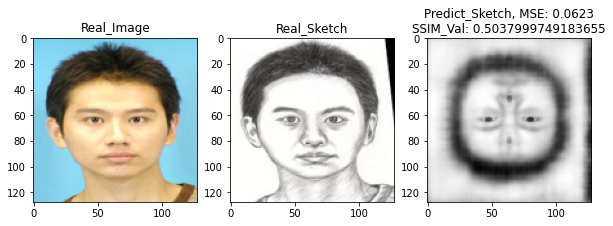

1/1 [==============================] - 0s 21ms/step


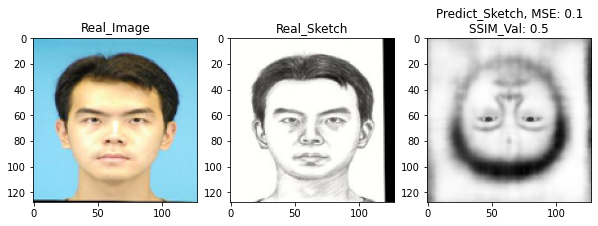

1/1 [==============================] - 0s 20ms/step


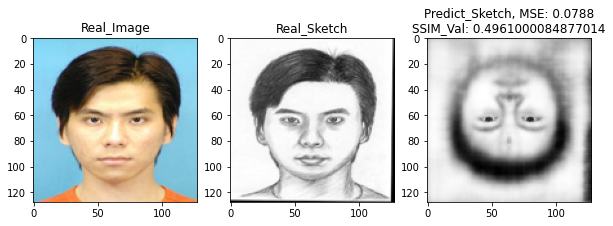

1/1 [==============================] - 0s 21ms/step


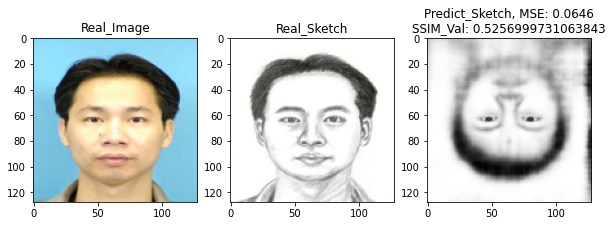

1/1 [==============================] - 0s 19ms/step


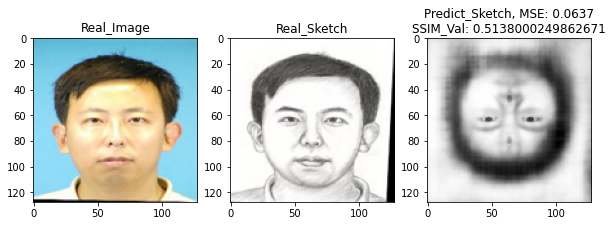

1/1 [==============================] - 0s 20ms/step


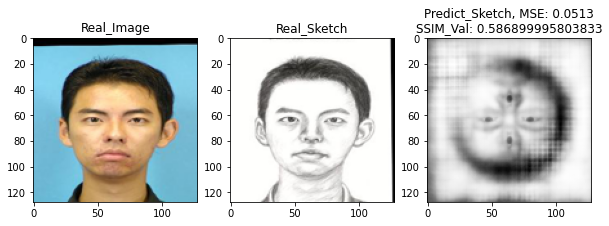

1/1 [==============================] - 0s 21ms/step


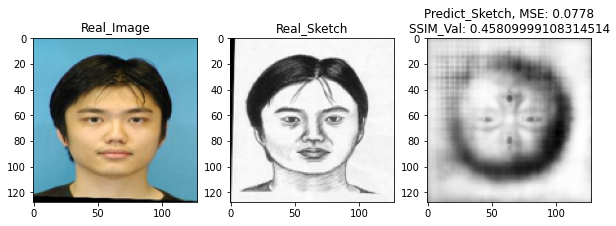

1/1 [==============================] - 0s 20ms/step


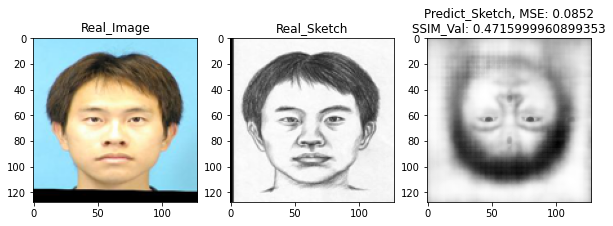

1/1 [==============================] - 0s 20ms/step


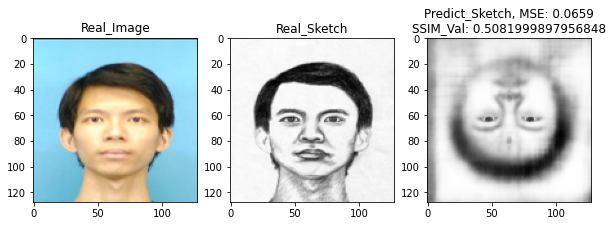

1/1 [==============================] - 0s 19ms/step


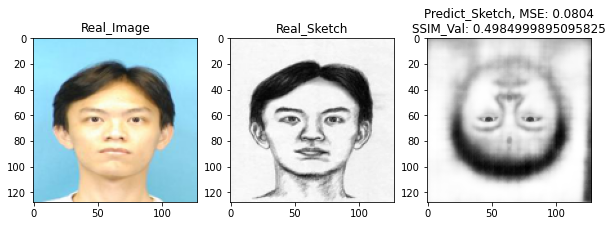

1/1 [==============================] - 0s 20ms/step


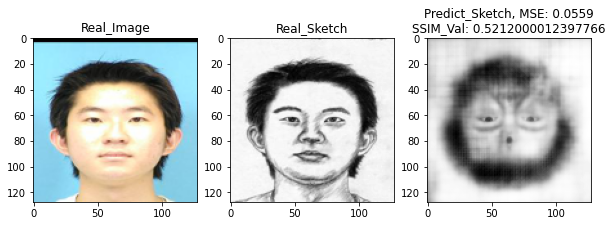

1/1 [==============================] - 0s 20ms/step


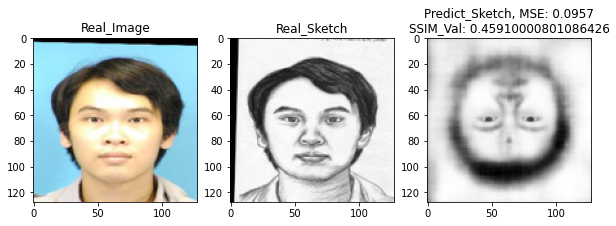

1/1 [==============================] - 0s 20ms/step


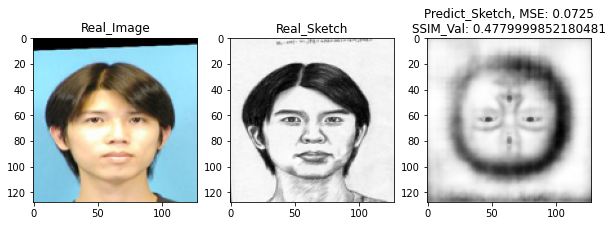

1/1 [==============================] - 0s 28ms/step


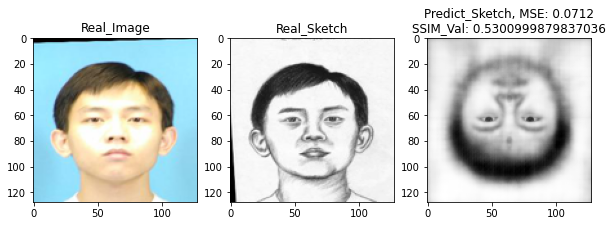

1/1 [==============================] - 0s 28ms/step


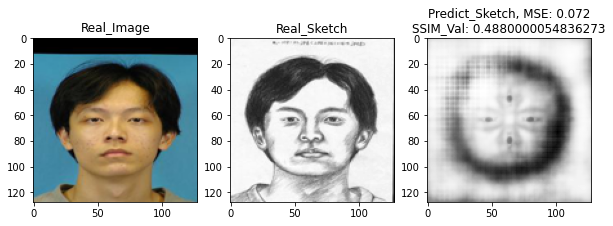

1/1 [==============================] - 0s 32ms/step


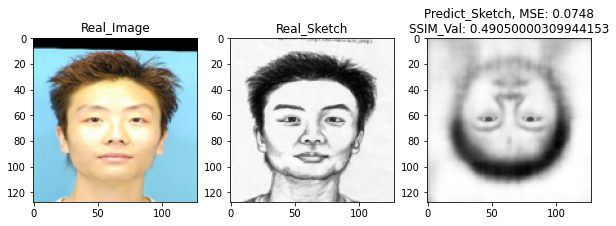

1/1 [==============================] - 0s 30ms/step


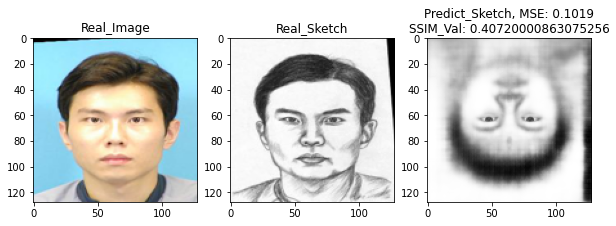

1/1 [==============================] - 0s 20ms/step


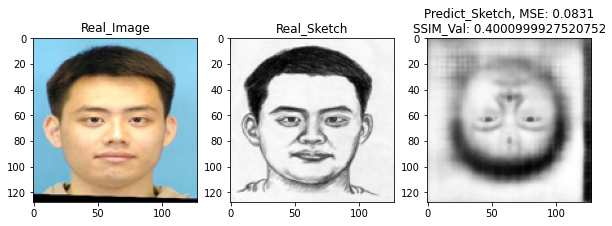

1/1 [==============================] - 0s 20ms/step


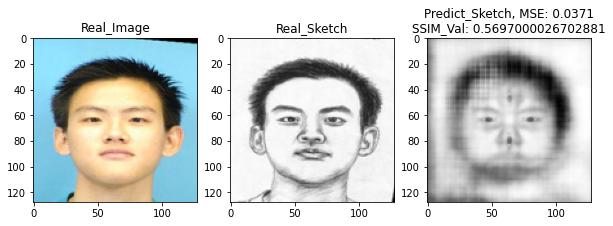

1/1 [==============================] - 0s 20ms/step


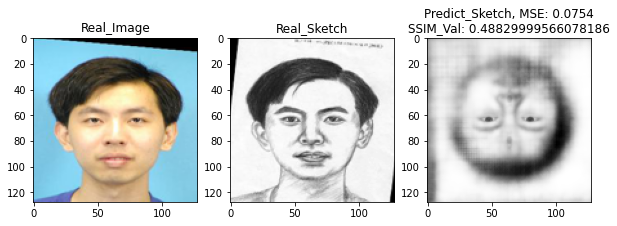

1/1 [==============================] - 0s 19ms/step


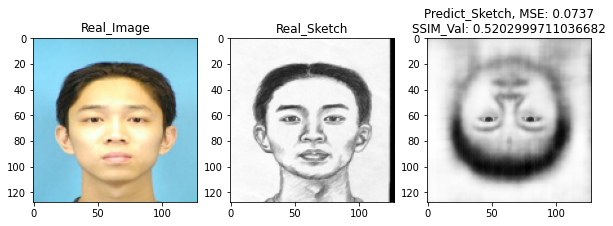

1/1 [==============================] - 0s 20ms/step


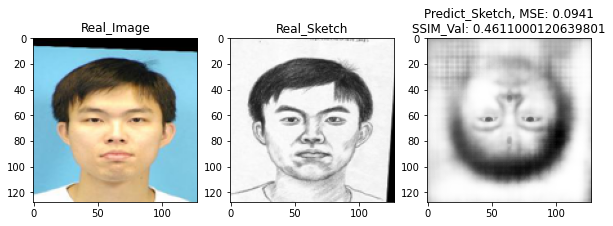

1/1 [==============================] - 0s 20ms/step


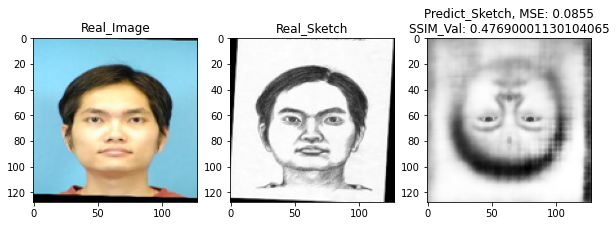

1/1 [==============================] - 0s 22ms/step


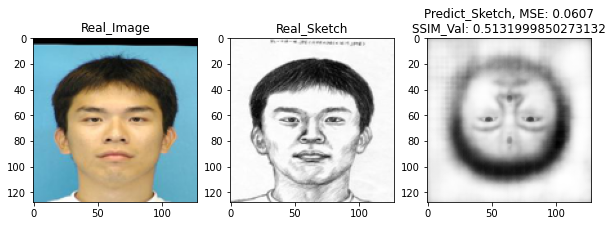

1/1 [==============================] - 0s 20ms/step


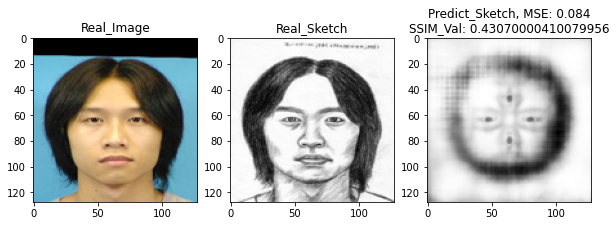

1/1 [==============================] - 0s 21ms/step


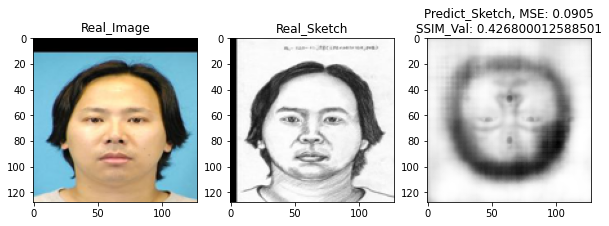

1/1 [==============================] - 0s 20ms/step


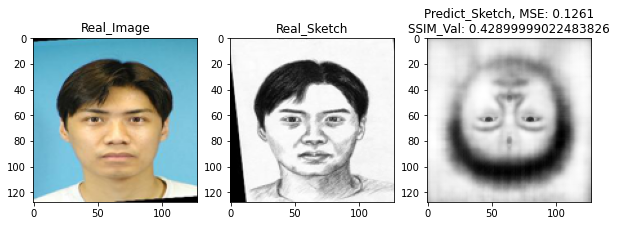

1/1 [==============================] - 0s 21ms/step


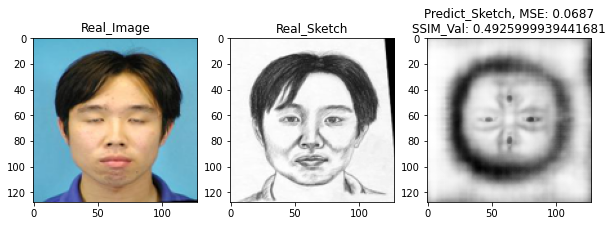

1/1 [==============================] - 0s 27ms/step


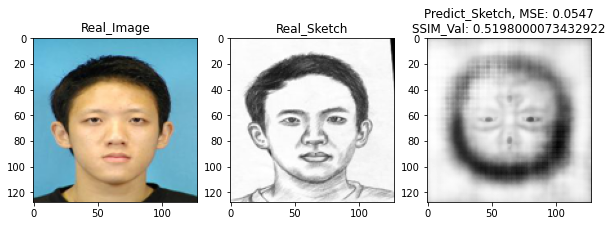

1/1 [==============================] - 0s 21ms/step


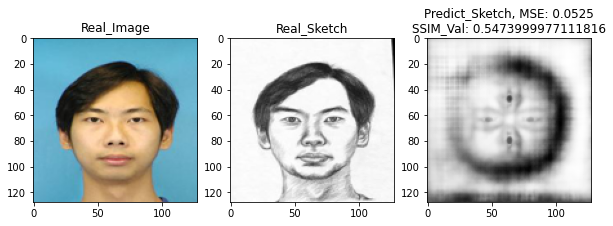

1/1 [==============================] - 0s 20ms/step


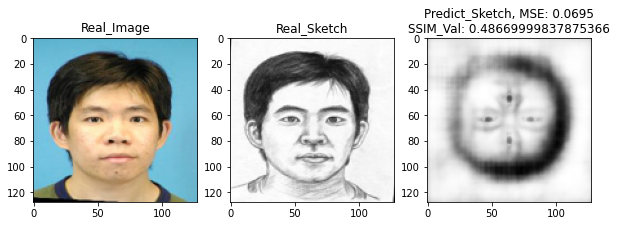

1/1 [==============================] - 0s 21ms/step


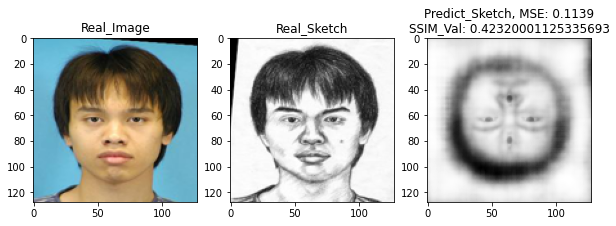

1/1 [==============================] - 0s 19ms/step


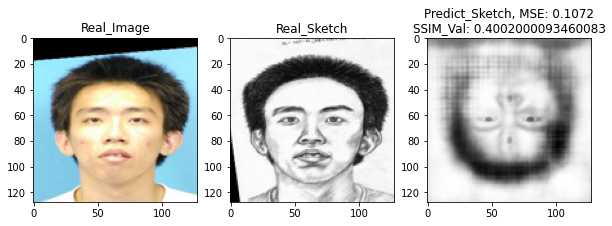

1/1 [==============================] - 0s 21ms/step


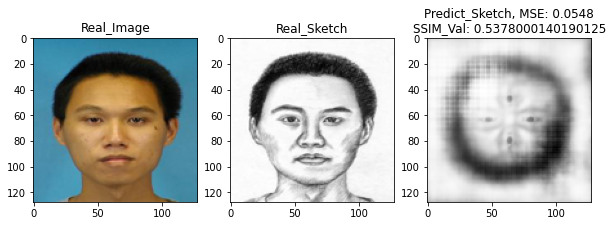

1/1 [==============================] - 0s 20ms/step


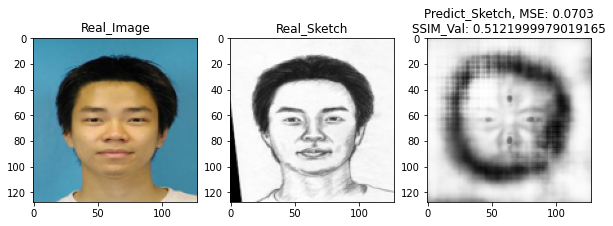

1/1 [==============================] - 0s 20ms/step


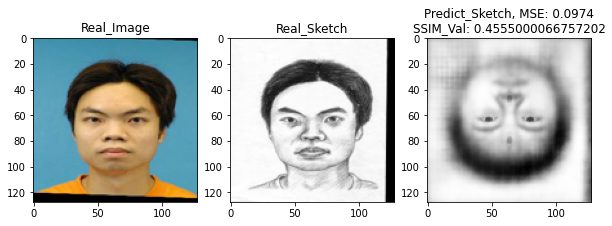

1/1 [==============================] - 0s 26ms/step


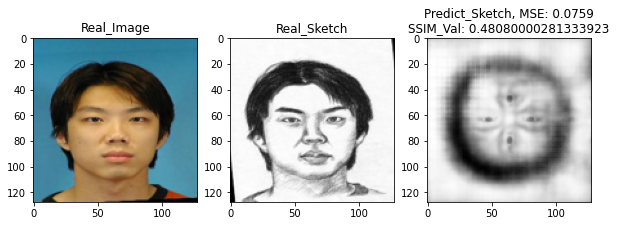

1/1 [==============================] - 0s 23ms/step


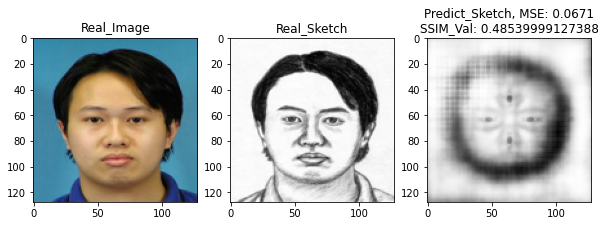

1/1 [==============================] - 0s 20ms/step


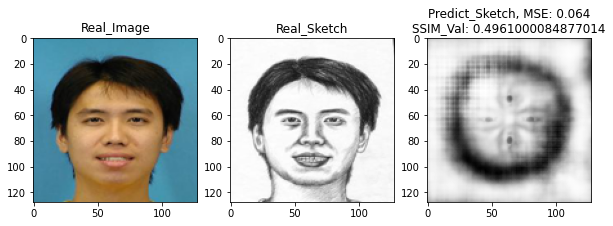

1/1 [==============================] - 0s 21ms/step


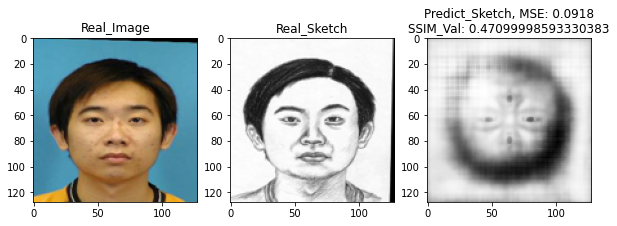

1/1 [==============================] - 0s 21ms/step


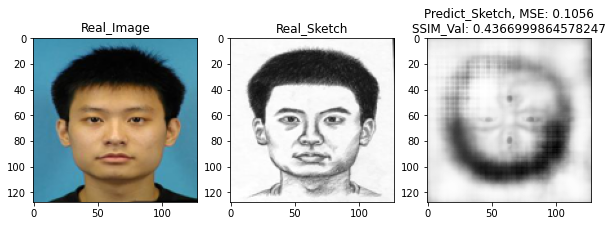

1/1 [==============================] - 0s 21ms/step


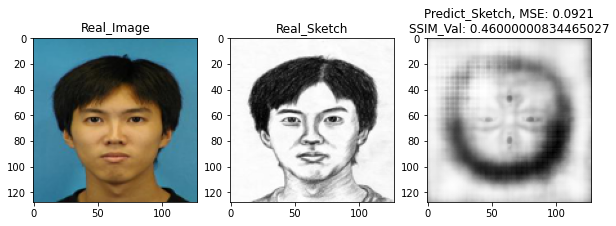

1/1 [==============================] - 0s 21ms/step


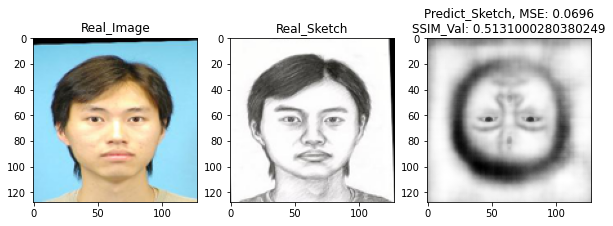

1/1 [==============================] - 0s 20ms/step


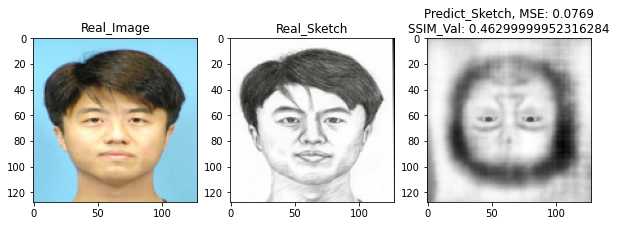

1/1 [==============================] - 0s 21ms/step


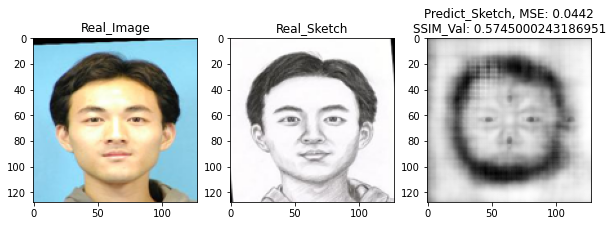

1/1 [==============================] - 0s 21ms/step


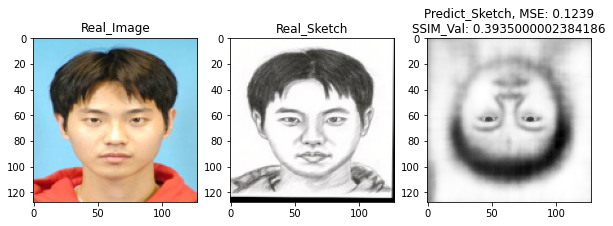

1/1 [==============================] - 0s 22ms/step


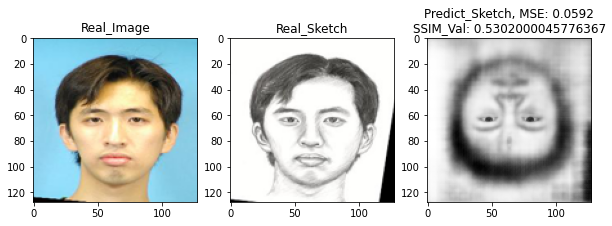

The overall MSE analysis of test dataset: Mean:0.0831, Max:0.1808, Min:0.0332
The overall SSIM_Val analysis of test dataset: Mean:0.47290000319480896, Max:0.586899995803833, Min:0.29589998722076416


In [15]:
filePath3 = '/content/SCC413/Keras_convVAE_dataset/CUHK_testing_cropped_photos'
filePath4 = '/content/SCC413/Keras_convVAE_dataset/CUHK_testing_cropped_sketches'
# Store all test cases' evaluations
MSE_all = []
SSIM_val_all = []
# 使用VAE模型生成素描图片
testPhotoFiles = list(sorted(os.listdir(filePath3)))
testSketchesFiles = list(sorted(os.listdir(filePath4)))

for i in range(len(testPhotoFiles)):
  fileName_Photo = testPhotoFiles[i]
  fileName_Sketch = testSketchesFiles[i]
  # 读取输入图片
  image_tmp = Image.open(os.path.join(filePath3, fileName_Photo))
  sketch_tmp = Image.open(os.path.join(filePath4, fileName_Sketch))
    
  # 转换为模型的输入格式
  image_tmp = image_tmp.resize((128, 128))
  img_tmp = np.array(image_tmp).reshape((1,128,128,3)).astype('float32') / 255.

  sketch_tmp = sketch_tmp.resize((128, 128))
#  print(len(np.array(sketch_tmp).shape))

  if len(np.array(sketch_tmp).shape) == 2:
    sketch_array_tmp = np.array(sketch_tmp).reshape((128,128,1)).astype('float32') / 255.
    sketch_array_rgb = cv2.cvtColor(sketch_array_tmp, cv2.COLOR_GRAY2RGB)
  else:
    sketch_array_rgb = np.array(sketch_tmp).reshape((128,128,3)).astype('float32') / 255.

  # 使用VAE模型生成素描图片
  sketch_Predict_img = ae.predict(img_tmp)
  sketch_Predict_img = np.clip(sketch_Predict_img, 0.0, 1.0)
  sketch_Predict_img = sketch_Predict_img.reshape(128,128,3)
  sketch_Predict_Image_gray = cv2.cvtColor(sketch_Predict_img, cv2.COLOR_BGR2GRAY)

  # Calculate MSE and SSIM of predict Image
  evaluations_tmp = imgPredictionEvaluate(realImg_array = sketch_array_rgb, predictImg_array = sketch_Predict_img)
  mse_tmp = evaluations_tmp[0]
  ssim_val_tmp = evaluations_tmp[1]
  MSE_all.append(mse_tmp)
  SSIM_val_all.append(ssim_val_tmp)

  # 显示生成的素描图片
  plt.figure(figsize = (10,10))

  plt.subplot(1,3,1)
  plt.title('Real_Image')
  plt.imshow(image_tmp)

  plt.subplot(1,3,2)
  plt.title('Real_Sketch')
  plt.imshow(sketch_tmp, cmap = 'gray') 

  plt.subplot(1,3,3)
  name = 'Predict_Sketch, MSE: {}\nSSIM_Val: {}'.format(mse_tmp, ssim_val_tmp)
  plt.title(name)
  plt.imshow(sketch_Predict_Image_gray, cmap = 'gray')
  plt.show()

# calculate the overall MSE & SSIM
MSE_all_Mean = round(np.mean(MSE_all), 4)
MSE_all_Max = np.max(MSE_all)
MSE_all_Min = np.min(MSE_all)

SSIM_val_all_Mean = round(np.mean(SSIM_val_all), 4)
SSIM_val_all_Max = np.max(SSIM_val_all)
SSIM_val_all_Min = np.min(SSIM_val_all) 

print('The overall MSE analysis of test dataset: Mean:{}, Max:{}, Min:{}'.format(MSE_all_Mean, MSE_all_Max, MSE_all_Min))
print('The overall SSIM_Val analysis of test dataset: Mean:{}, Max:{}, Min:{}'.format(SSIM_val_all_Mean, SSIM_val_all_Max, SSIM_val_all_Min))